# Feature Engineering Notebook

## Objectives

* Engineer features for Regression models

## Inputs

* outputs/datasets/cleaned/TestSetCleaned.csv
* outputs/datasets/cleaned/TrainSetCleaned.csv

## Outputs

* Generate a list with features to engineer


---

# Change working directory

We need to change the working directory from its current folder to its parent folder
* We access the current directory with os.getcwd()

In [1]:
import os
current_dir = os.getcwd()
current_dir

'/workspaces/milestone-project-heritage-housing-issues/jupyter_notebooks'

We want to make the parent of the current directory the new current directory
* os.path.dirname() gets the parent directory
* os.chir() defines the new current directory

In [2]:
os.chdir(os.path.dirname(current_dir))
print("You set a new current directory")

You set a new current directory


Confirm the new current directory

In [4]:
current_dir = os.getcwd()
current_dir

'/workspaces/milestone-project-heritage-housing-issues'

---

# Load the cleaned data

Train set

In [5]:
import pandas as pd
TrainSet = pd.read_csv("outputs/datasets/cleaned/TrainSetCleaned.csv")
TrainSet.head()

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtUnfSF,GarageArea,GarageFinish,GarageYrBlt,...,LotArea,LotFrontage,MasVnrArea,OpenPorchSF,OverallCond,OverallQual,TotalBsmtSF,YearBuilt,YearRemodAdd,SalePrice
0,1828,0.0,3.0,Av,48,Missing,1774,774,Unf,2007.0,...,11694,90.0,452.0,108,5,9,1822,2007,2007,314813
1,894,0.0,2.0,No,0,Unf,894,308,Unf,1962.0,...,6600,60.0,0.0,0,5,5,894,1962,1962,109500
2,964,0.0,2.0,No,713,ALQ,163,432,Unf,1921.0,...,13360,80.0,0.0,0,7,5,876,1921,2006,163500
3,1689,0.0,3.0,No,1218,GLQ,350,857,RFn,2002.0,...,13265,70.0,148.0,59,5,8,1568,2002,2002,271000
4,1541,0.0,3.0,No,0,Unf,1541,843,RFn,2001.0,...,13704,118.0,150.0,81,5,7,1541,2001,2002,205000


Test set

In [6]:
TestSet = pd.read_csv("outputs/datasets/cleaned/TestSetCleaned.csv")
TestSet.head()

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtUnfSF,GarageArea,GarageFinish,GarageYrBlt,...,LotArea,LotFrontage,MasVnrArea,OpenPorchSF,OverallCond,OverallQual,TotalBsmtSF,YearBuilt,YearRemodAdd,SalePrice
0,2515,0.0,4.0,No,1219,Rec,816,484,Unf,1975.0,...,32668,70.0,0.0,0,3,6,2035,1957,1975,200624
1,958,620.0,3.0,No,403,BLQ,238,240,Unf,1941.0,...,9490,79.0,0.0,0,7,6,806,1941,1950,133000
2,979,224.0,3.0,No,185,LwQ,524,352,Unf,1950.0,...,7015,70.0,161.0,0,4,5,709,1950,1950,110000
3,1156,866.0,4.0,No,392,BLQ,768,505,Fin,1977.0,...,10005,83.0,299.0,117,5,7,1160,1977,1977,192000
4,525,0.0,3.0,No,0,Unf,525,264,Unf,1971.0,...,1680,21.0,381.0,0,5,6,525,1971,1971,88000


---

# Data Exploration

In feature engineering we are interested to evaluate which potential transformation we can do to the features

In [6]:
from pandas_profiling import ProfileReport
pandas_report = ProfileReport(df=TrainSet, minimal=True)
pandas_report.to_notebook_iframe()

Matplotlib is building the font cache; this may take a moment.


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Correlation and PPS Analysis

We got this code from the codeinstitute churnometer walkthrough.

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import ppscore as pps

%matplotlib inline

def heatmap_corr(df, threshold, figsize=(20, 12), font_annot=8):
    if len(df.columns) > 1:
        mask = np.zeros_like(df, dtype=np.bool)
        mask[np.triu_indices_from(mask)] = True
        mask[abs(df) < threshold] = True

        fig, axes = plt.subplots(figsize=figsize)
        sns.heatmap(df, annot=True, xticklabels=True, yticklabels=True,
                    mask=mask, cmap='viridis', annot_kws={"size": font_annot}, ax=axes,
                    linewidth=0.5
                    )
        axes.set_yticklabels(df.columns, rotation=0)
        plt.ylim(len(df.columns), 0)
        plt.show()


def heatmap_pps(df, threshold, figsize=(20, 12), font_annot=8):
    if len(df.columns) > 1:
        mask = np.zeros_like(df, dtype=np.bool)
        mask[abs(df) < threshold] = True
        fig, ax = plt.subplots(figsize=figsize)
        ax = sns.heatmap(df, annot=True, xticklabels=True, yticklabels=True,
                         mask=mask, cmap='rocket_r', annot_kws={"size": font_annot},
                         linewidth=0.05, linecolor='grey')
        plt.ylim(len(df.columns), 0)
        plt.show()


def CalculateCorrAndPPS(df):
    df_corr_spearman = df.corr(method="spearman")
    df_corr_pearson = df.corr(method="pearson")

    pps_matrix_raw = pps.matrix(df)
    pps_matrix = pps_matrix_raw.filter(['x', 'y', 'ppscore']).pivot(columns='x', index='y', values='ppscore')

    pps_score_stats = pps_matrix_raw.query("ppscore < 1").filter(['ppscore']).describe().T
    print("PPS threshold - check PPS score IQR to decide threshold for heatmap \n")
    print(pps_score_stats.round(3))

    return df_corr_pearson, df_corr_spearman, pps_matrix


def DisplayCorrAndPPS(df_corr_pearson, df_corr_spearman, pps_matrix, CorrThreshold, PPS_Threshold,
                      figsize=(20, 12), font_annot=8):

    print("\n")
    print("* Analyse how the target variable for your ML models are correlated with other variables (features and target)")
    print("* Analyse multi-colinearity, that is, how the features are correlated among themselves")

    print("\n")
    print("*** Heatmap: Spearman Correlation ***")
    print("It evaluates monotonic relationship \n")
    heatmap_corr(df=df_corr_spearman, threshold=CorrThreshold, figsize=figsize, font_annot=font_annot)

    print("\n")
    print("*** Heatmap: Pearson Correlation ***")
    print("It evaluates the linear relationship between two continuous variables \n")
    heatmap_corr(df=df_corr_pearson, threshold=CorrThreshold, figsize=figsize, font_annot=font_annot)

    print("\n")
    print("*** Heatmap: Power Predictive Score (PPS) ***")
    print(f"PPS detects linear or non-linear relationships between two columns.\n"
          f"The score ranges from 0 (no predictive power) to 1 (perfect predictive power) \n")
    heatmap_pps(df=pps_matrix, threshold=PPS_Threshold, figsize=figsize, font_annot=font_annot)

## Calculate Correlations and Power Predictive score

We can see that the TrainSet gives us an IQR of 0.0 to 0.071

In [8]:
df_corr_pearson, df_corr_spearman, pps_matrix = CalculateCorrAndPPS(TrainSet)

PPS threshold - check PPS score IQR to decide threshold for heatmap 

         count   mean    std  min  25%  50%    75%    max
ppscore  462.0  0.059  0.106  0.0  0.0  0.0  0.071  0.618


## Heatmaps

We have set the correlation threshold to 0.5 and the PPS threshold to 0.3.



* Analyse how the target variable for your ML models are correlated with other variables (features and target)
* Analyse multi-colinearity, that is, how the features are correlated among themselves


*** Heatmap: Spearman Correlation ***
It evaluates monotonic relationship 



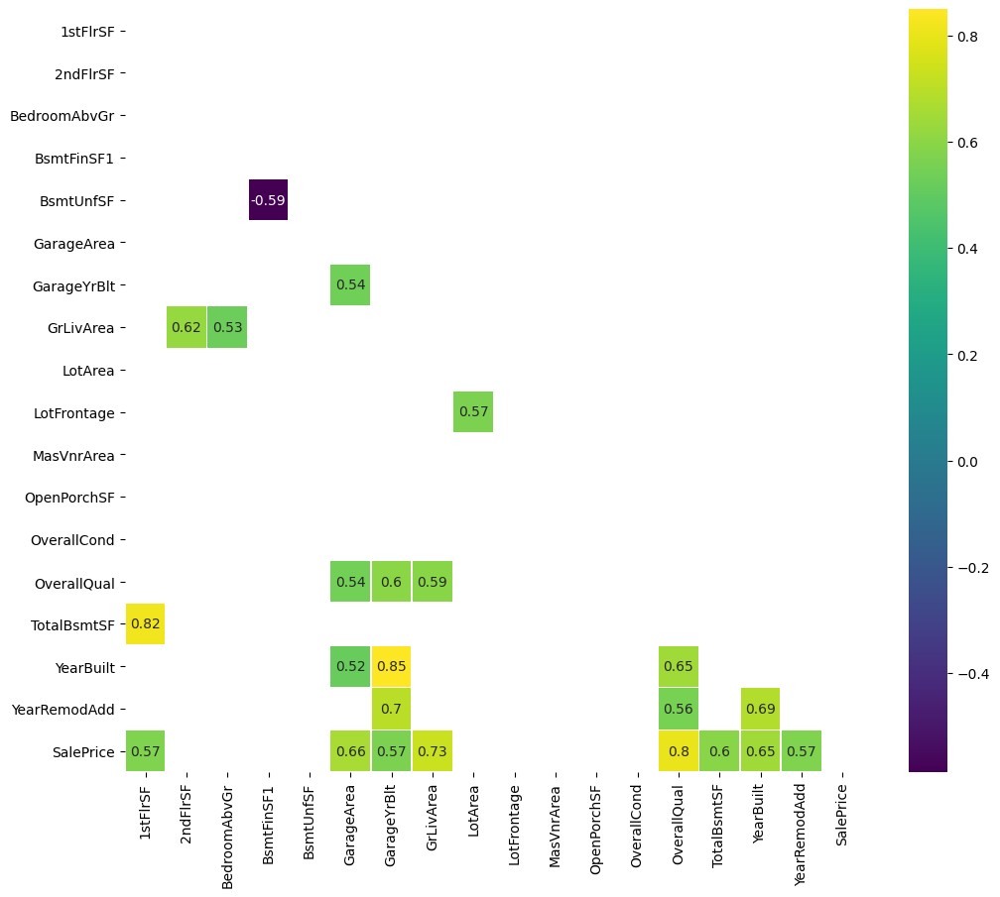



*** Heatmap: Pearson Correlation ***
It evaluates the linear relationship between two continuous variables 



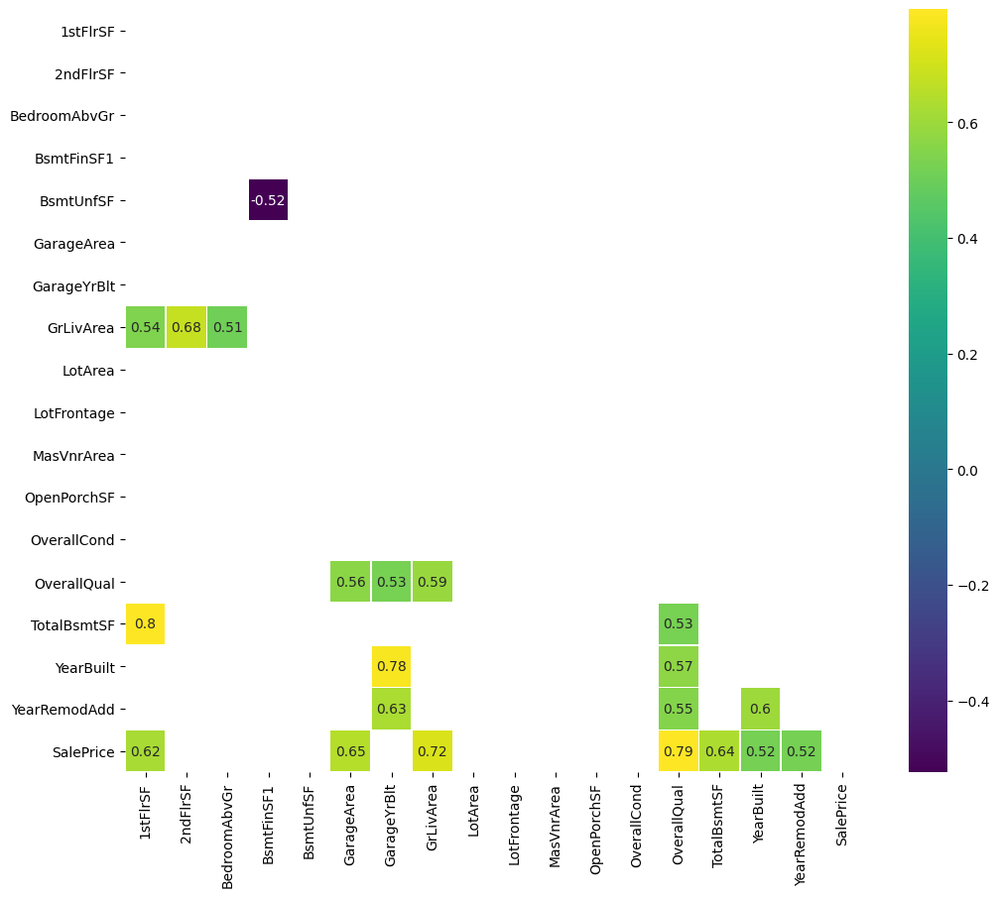



*** Heatmap: Power Predictive Score (PPS) ***
PPS detects linear or non-linear relationships between two columns.
The score ranges from 0 (no predictive power) to 1 (perfect predictive power) 



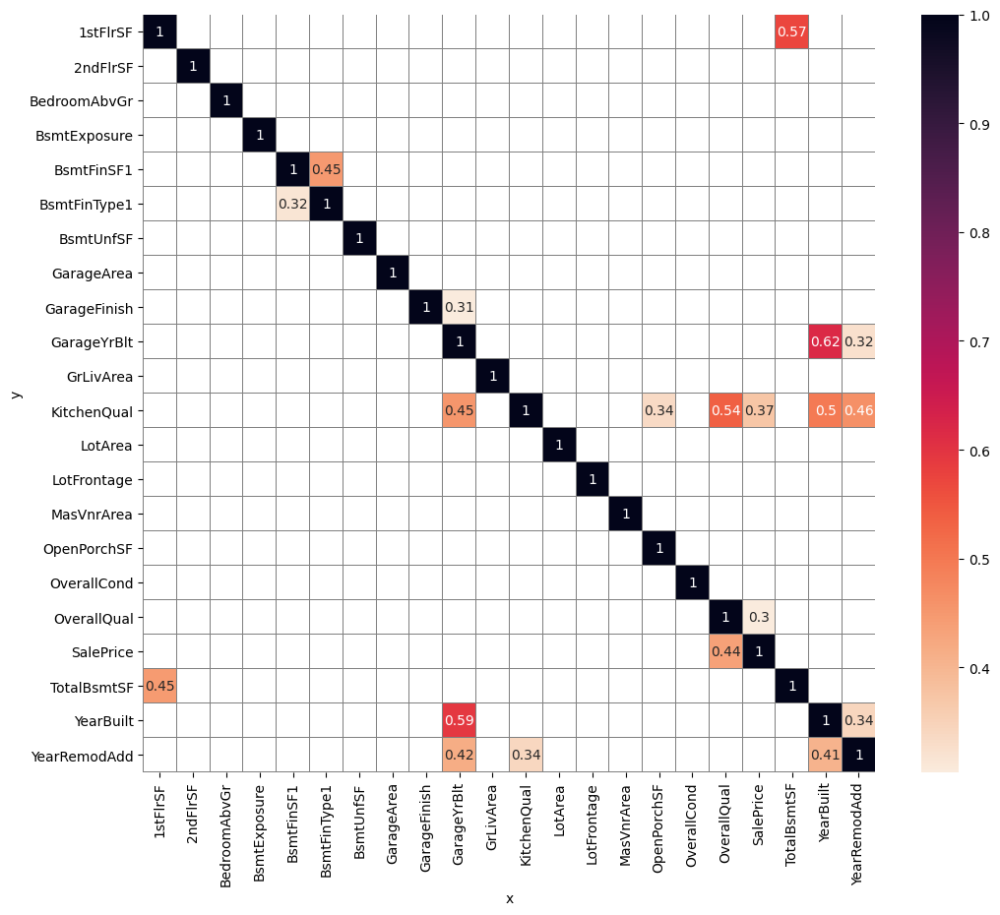

In [9]:
DisplayCorrAndPPS(df_corr_pearson = df_corr_pearson,
                  df_corr_spearman = df_corr_spearman, 
                  pps_matrix = pps_matrix,
                  CorrThreshold = 0.5, PPS_Threshold =0.3,
                  figsize=(12,10), font_annot=10)

---

# Feature Engineering

## Custom function

We got this code from the codeinstitute churnometer walkthrough.

In [10]:
import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import warnings
from feature_engine import transformation as vt
from feature_engine.outliers import Winsorizer
from feature_engine.encoding import OrdinalEncoder
sns.set(style="whitegrid")
warnings.filterwarnings('ignore')


def FeatureEngineeringAnalysis(df, analysis_type=None):
    """
    - used for quick feature engineering on numerical and categorical variables
    to decide which transformation can better transform the distribution shape
    - Once transformed, use a reporting tool, like pandas-profiling, to evaluate distributions
    """
    check_missing_values(df)
    allowed_types = ['numerical', 'ordinal_encoder', 'outlier_winsorizer']
    check_user_entry_on_analysis_type(analysis_type, allowed_types)
    list_column_transformers = define_list_column_transformers(analysis_type)

    # Loop in each variable and engineer the data according to the analysis type
    df_feat_eng = pd.DataFrame([])
    for column in df.columns:
        # create additional columns (column_method) to apply the methods
        df_feat_eng = pd.concat([df_feat_eng, df[column]], axis=1)
        for method in list_column_transformers:
            df_feat_eng[f"{column}_{method}"] = df[column]

        # Apply transformers in respective column_transformers
        df_feat_eng, list_applied_transformers = apply_transformers(
            analysis_type, df_feat_eng, column)

        # For each variable, assess how the transformations perform
        transformer_evaluation(
            column, list_applied_transformers, analysis_type, df_feat_eng)

    return df_feat_eng


def check_user_entry_on_analysis_type(analysis_type, allowed_types):
    """ Check analysis type """
    if analysis_type is None:
        raise SystemExit(
            f"You should pass analysis_type parameter as one of the following options: {allowed_types}")
    if analysis_type not in allowed_types:
        raise SystemExit(
            f"analysis_type argument should be one of these options: {allowed_types}")


def check_missing_values(df):
    if df.isna().sum().sum() != 0:
        raise SystemExit(
            f"There is a missing value in your dataset. Please handle that before getting into feature engineering.")


def define_list_column_transformers(analysis_type):
    """ Set suffix columns according to analysis_type"""
    if analysis_type == 'numerical':
        list_column_transformers = [
            "log_e", "log_10", "reciprocal", "power", "box_cox", "yeo_johnson"]

    elif analysis_type == 'ordinal_encoder':
        list_column_transformers = ["ordinal_encoder"]

    elif analysis_type == 'outlier_winsorizer':
        list_column_transformers = ['iqr']

    return list_column_transformers


def apply_transformers(analysis_type, df_feat_eng, column):
    for col in df_feat_eng.select_dtypes(include='category').columns:
        df_feat_eng[col] = df_feat_eng[col].astype('object')

    if analysis_type == 'numerical':
        df_feat_eng, list_applied_transformers = FeatEngineering_Numerical(
            df_feat_eng, column)

    elif analysis_type == 'outlier_winsorizer':
        df_feat_eng, list_applied_transformers = FeatEngineering_OutlierWinsorizer(
            df_feat_eng, column)

    elif analysis_type == 'ordinal_encoder':
        df_feat_eng, list_applied_transformers = FeatEngineering_CategoricalEncoder(
            df_feat_eng, column)

    return df_feat_eng, list_applied_transformers


def transformer_evaluation(column, list_applied_transformers, analysis_type, df_feat_eng):
    # For each variable, assess how the transformations perform
    print(f"* Variable Analyzed: {column}")
    print(f"* Applied transformation: {list_applied_transformers} \n")
    for col in [column] + list_applied_transformers:

        if analysis_type != 'ordinal_encoder':
            DiagnosticPlots_Numerical(df_feat_eng, col)

        else:
            if col == column:
                DiagnosticPlots_Categories(df_feat_eng, col)
            else:
                DiagnosticPlots_Numerical(df_feat_eng, col)

        print("\n")


def DiagnosticPlots_Categories(df_feat_eng, col):
    plt.figure(figsize=(4, 3))
    sns.countplot(data=df_feat_eng, x=col, palette=[
                  '#432371'], order=df_feat_eng[col].value_counts().index)
    plt.xticks(rotation=90)
    plt.suptitle(f"{col}", fontsize=30, y=1.05)
    plt.show()
    print("\n")


def DiagnosticPlots_Numerical(df, variable):
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))
    sns.histplot(data=df, x=variable, kde=True, element="step", ax=axes[0])
    stats.probplot(df[variable], dist="norm", plot=axes[1])
    sns.boxplot(x=df[variable], ax=axes[2])

    axes[0].set_title('Histogram')
    axes[1].set_title('QQ Plot')
    axes[2].set_title('Boxplot')
    fig.suptitle(f"{variable}", fontsize=30, y=1.05)
    plt.tight_layout()
    plt.show()


def FeatEngineering_CategoricalEncoder(df_feat_eng, column):
    list_methods_worked = []
    try:
        encoder = OrdinalEncoder(encoding_method='arbitrary', variables=[
                                 f"{column}_ordinal_encoder"])
        df_feat_eng = encoder.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_ordinal_encoder")

    except Exception:
        df_feat_eng.drop([f"{column}_ordinal_encoder"], axis=1, inplace=True)

    return df_feat_eng, list_methods_worked


def FeatEngineering_OutlierWinsorizer(df_feat_eng, column):
    list_methods_worked = []

    # Winsorizer iqr
    try:
        disc = Winsorizer(
            capping_method='iqr', tail='both', fold=1.5, variables=[f"{column}_iqr"])
        df_feat_eng = disc.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_iqr")
    except Exception:
        df_feat_eng.drop([f"{column}_iqr"], axis=1, inplace=True)

    return df_feat_eng, list_methods_worked


def FeatEngineering_Numerical(df_feat_eng, column):
    list_methods_worked = []

    # LogTransformer base e
    try:
        lt = vt.LogTransformer(variables=[f"{column}_log_e"])
        df_feat_eng = lt.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_log_e")
    except Exception:
        df_feat_eng.drop([f"{column}_log_e"], axis=1, inplace=True)

    # LogTransformer base 10
    try:
        lt = vt.LogTransformer(variables=[f"{column}_log_10"], base='10')
        df_feat_eng = lt.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_log_10")
    except Exception:
        df_feat_eng.drop([f"{column}_log_10"], axis=1, inplace=True)

    # ReciprocalTransformer
    try:
        rt = vt.ReciprocalTransformer(variables=[f"{column}_reciprocal"])
        df_feat_eng = rt.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_reciprocal")
    except Exception:
        df_feat_eng.drop([f"{column}_reciprocal"], axis=1, inplace=True)

    # PowerTransformer
    try:
        pt = vt.PowerTransformer(variables=[f"{column}_power"])
        df_feat_eng = pt.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_power")
    except Exception:
        df_feat_eng.drop([f"{column}_power"], axis=1, inplace=True)

    # BoxCoxTransformer
    try:
        bct = vt.BoxCoxTransformer(variables=[f"{column}_box_cox"])
        df_feat_eng = bct.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_box_cox")
    except Exception:
        df_feat_eng.drop([f"{column}_box_cox"], axis=1, inplace=True)

    # YeoJohnsonTransformer
    try:
        yjt = vt.YeoJohnsonTransformer(variables=[f"{column}_yeo_johnson"])
        df_feat_eng = yjt.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_yeo_johnson")
    except Exception:
        df_feat_eng.drop([f"{column}_yeo_johnson"], axis=1, inplace=True)

    return df_feat_eng, list_methods_worked

The transformers we will use are:
* Categorical Encoding
* Numerical Transformation
* Smart Correlation Selection

## Dealing with Feature Engineering

### Categorical Encoding - Ordinal

We use this feature engineering to change features with category inputs to a numerical input for each number corresponding to one category.

We have looked at the profile report above and have selected the features: BsmtExposure, BsmtFinType1, GarageFinish and KitchenQual as suitable features for this encoding.

In [11]:
variables_ordinal_engineering = ['BsmtExposure', 'BsmtFinType1', 'GarageFinish', 'KitchenQual']
variables_ordinal_engineering

['BsmtExposure', 'BsmtFinType1', 'GarageFinish', 'KitchenQual']

In [12]:
df_ordinal_engineering = TrainSet[variables_ordinal_engineering].copy()
df_ordinal_engineering.head()

,BsmtExposure,BsmtFinType1,GarageFinish,KitchenQual
0,Av,Missing,Unf,Gd
1,No,Unf,Unf,TA
2,No,ALQ,Unf,TA
3,No,GLQ,RFn,Gd
4,No,Unf,RFn,Gd


* Variable Analyzed: BsmtExposure
* Applied transformation: ['BsmtExposure_ordinal_encoder'] 



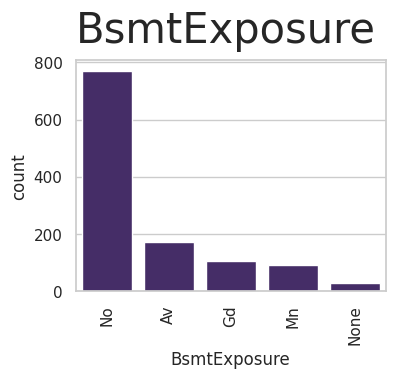

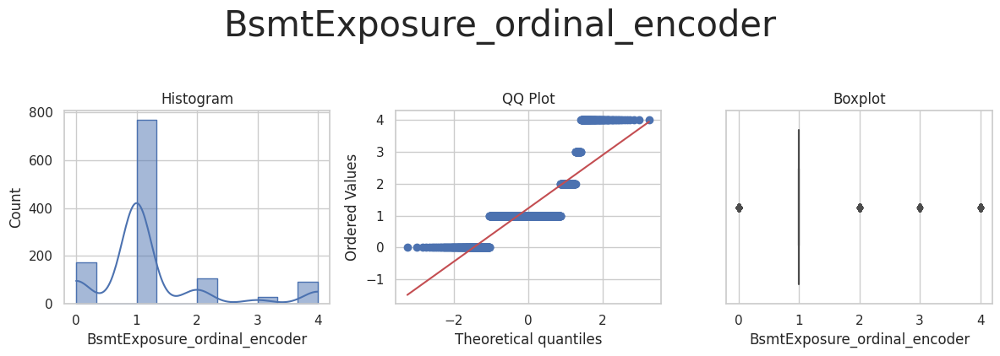



* Variable Analyzed: BsmtFinType1
* Applied transformation: ['BsmtFinType1_ordinal_encoder'] 



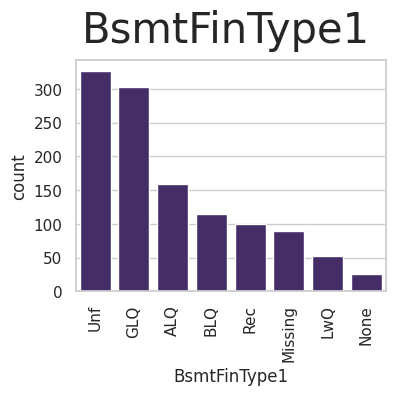

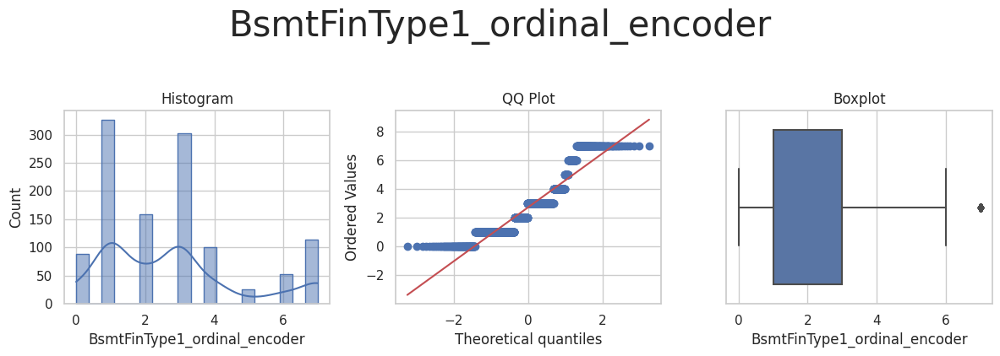



* Variable Analyzed: GarageFinish
* Applied transformation: ['GarageFinish_ordinal_encoder'] 



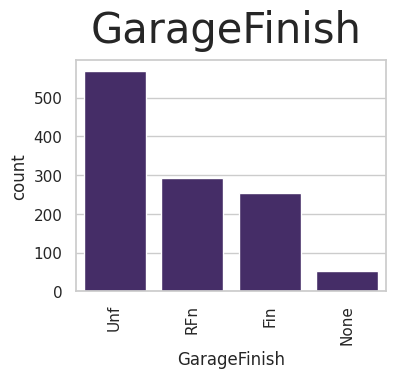

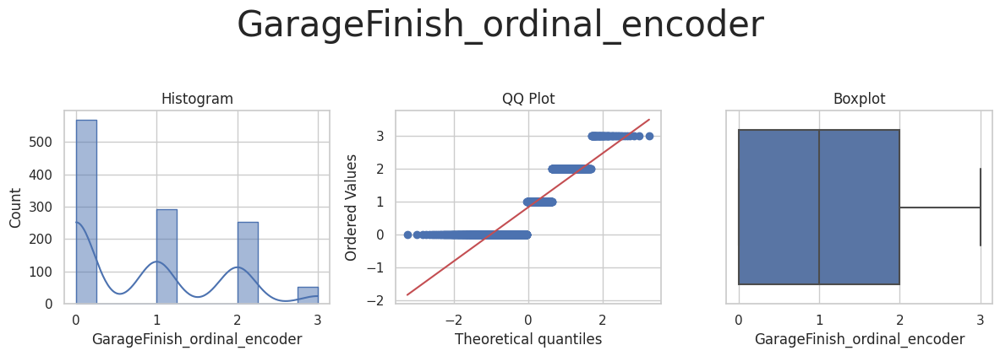



* Variable Analyzed: KitchenQual
* Applied transformation: ['KitchenQual_ordinal_encoder'] 



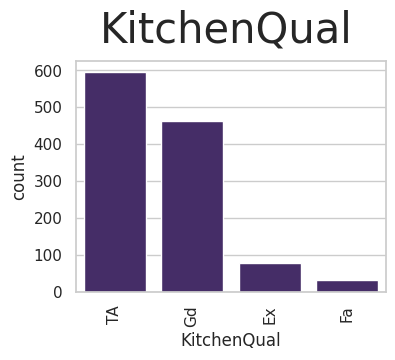

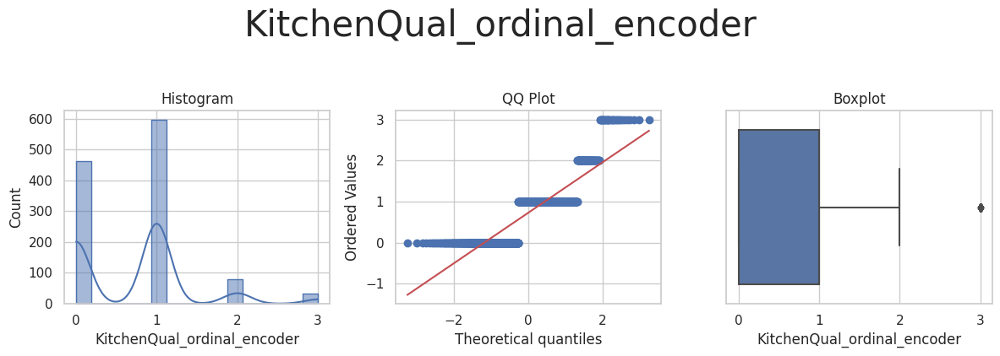

In [13]:
df_ordinal_engineering = FeatureEngineeringAnalysis(df=df_ordinal_engineering, analysis_type='ordinal_encoder')

Conclusion on the categorical encoding - ordinal:
* BsmtExposure - We can see that all categories have been successfully transformed into numbers.
* BsmtFinType1 - We can see that all categories have been successfully transformed into numbers.
* GarageFinish - We can see that all categories have been successfully transformed into numbers.
* KitchenQual - We can see that all categories have been successfully transformed into numbers.

We can therefore see that all features were successfully transformed so we can transform both TrainSet and TestSet.

In [14]:
encoder_ordinal = OrdinalEncoder(encoding_method='arbitrary', variables=variables_ordinal_engineering)
TrainSet = encoder_ordinal.fit_transform(TrainSet)
TestSet = encoder_ordinal.transform(TestSet)

print("Categorical encoding - ordinal transformation completed")

Categorical encoding - ordinal transformation completed


### Numerical Transformation

We use this feature engineering to change the distribution of the numerical features with different mathematical transformations. For these transformation I have selected the features below as suitable for the following transformations.

In [16]:
variables_numerical_engineering = ['1stFlrSF', '2ndFlrSF', 'BsmtFinSF1', 'BsmtUnfSF', 'GarageArea', 'GrLivArea', 'LotArea', 'LotFrontage', 'MasVnrArea', 'OpenPorchSF', 'TotalBsmtSF', 'GarageYrBlt', 'YearBuilt', 'YearRemodAdd']
variables_numerical_engineering

['1stFlrSF',
 '2ndFlrSF',
 'BedroomAbvGr',
 'BsmtFinSF1',
 'BsmtUnfSF',
 'GarageArea',
 'GrLivArea',
 'LotArea',
 'LotFrontage',
 'MasVnrArea',
 'OpenPorchSF',
 'TotalBsmtSF',
 'GarageYrBlt',
 'YearBuilt',
 'YearRemodAdd']

In [17]:
df_numerical_engineering = TrainSet[variables_numerical_engineering].copy()
df_numerical_engineering.head()

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtFinSF1,BsmtUnfSF,GarageArea,GrLivArea,LotArea,LotFrontage,MasVnrArea,OpenPorchSF,TotalBsmtSF,GarageYrBlt,YearBuilt,YearRemodAdd
0,1828,0.0,3.0,48,1774,774,1828,11694,90.0,452.0,108,1822,2007.0,2007,2007
1,894,0.0,2.0,0,894,308,894,6600,60.0,0.0,0,894,1962.0,1962,1962
2,964,0.0,2.0,713,163,432,964,13360,80.0,0.0,0,876,1921.0,1921,2006
3,1689,0.0,3.0,1218,350,857,1689,13265,70.0,148.0,59,1568,2002.0,2002,2002
4,1541,0.0,3.0,0,1541,843,1541,13704,118.0,150.0,81,1541,2001.0,2001,2002


* Variable Analyzed: 1stFlrSF
* Applied transformation: ['1stFlrSF_log_e', '1stFlrSF_log_10', '1stFlrSF_reciprocal', '1stFlrSF_power', '1stFlrSF_box_cox', '1stFlrSF_yeo_johnson'] 



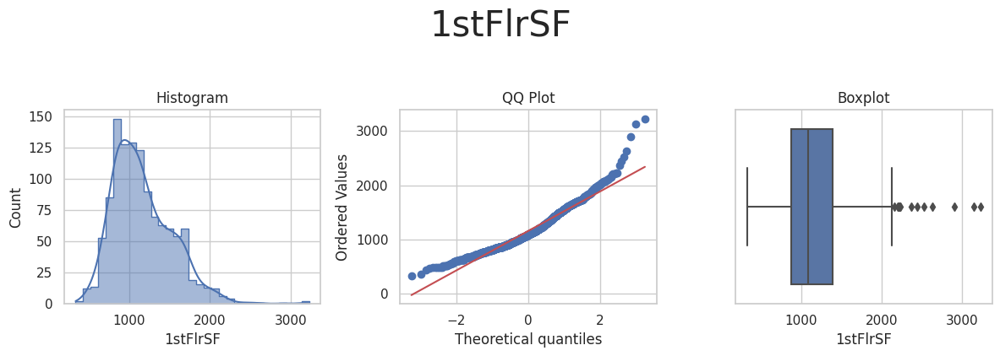

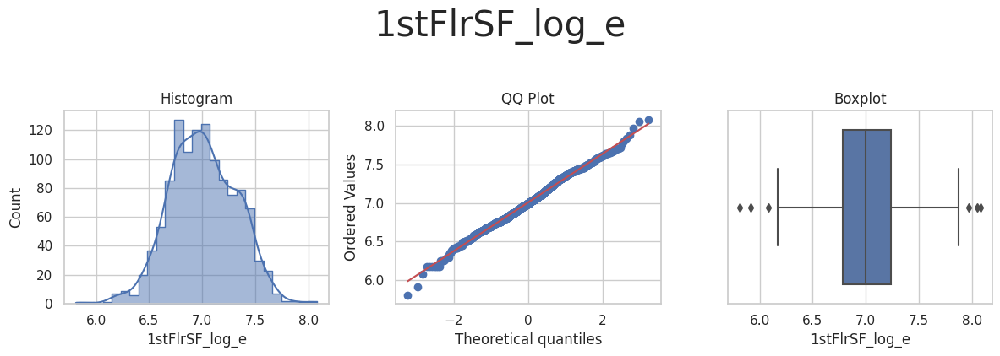

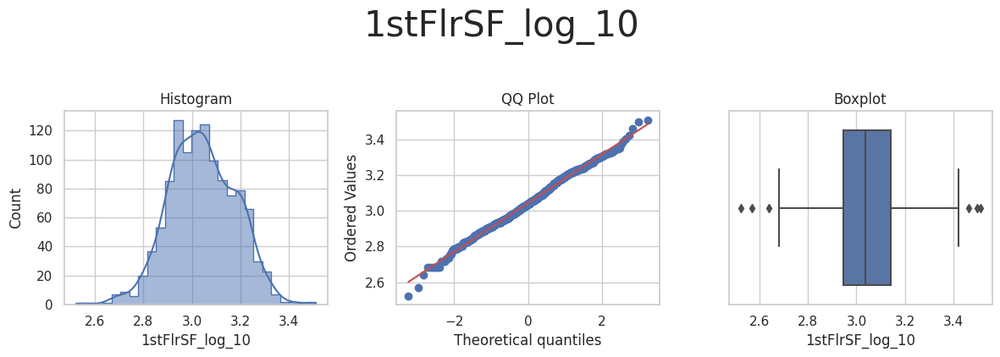

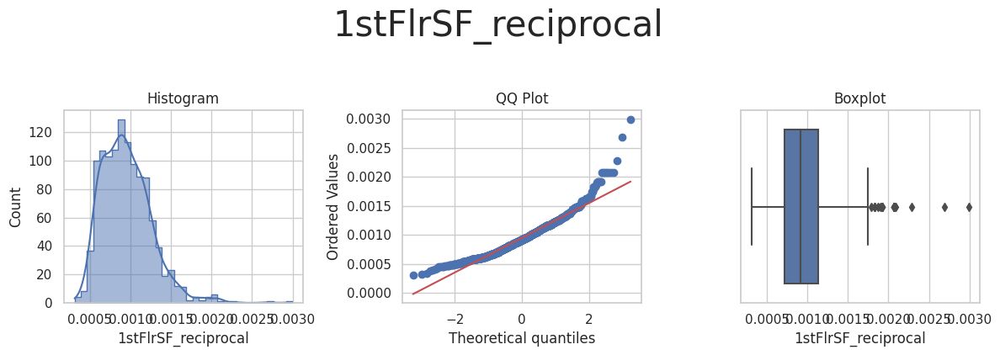

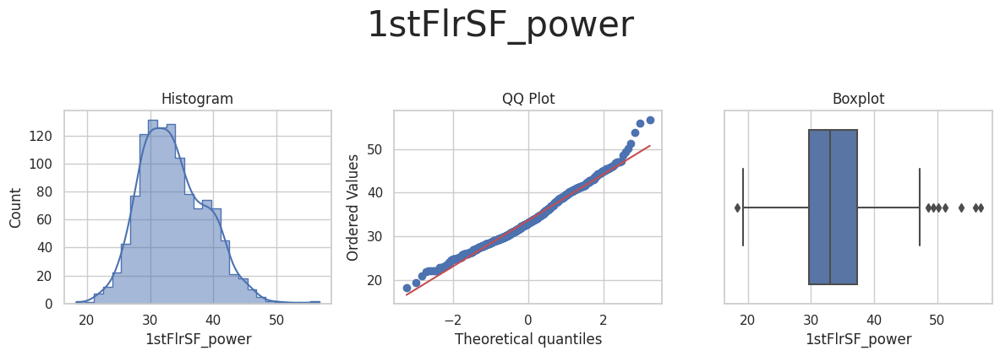

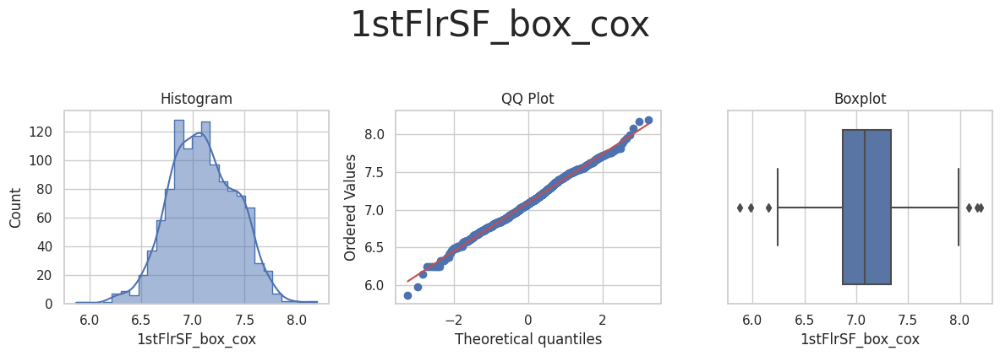

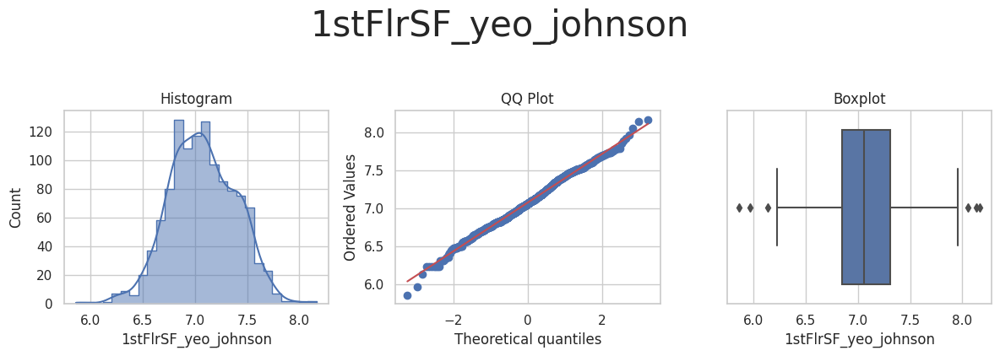



* Variable Analyzed: 2ndFlrSF
* Applied transformation: ['2ndFlrSF_power', '2ndFlrSF_yeo_johnson'] 



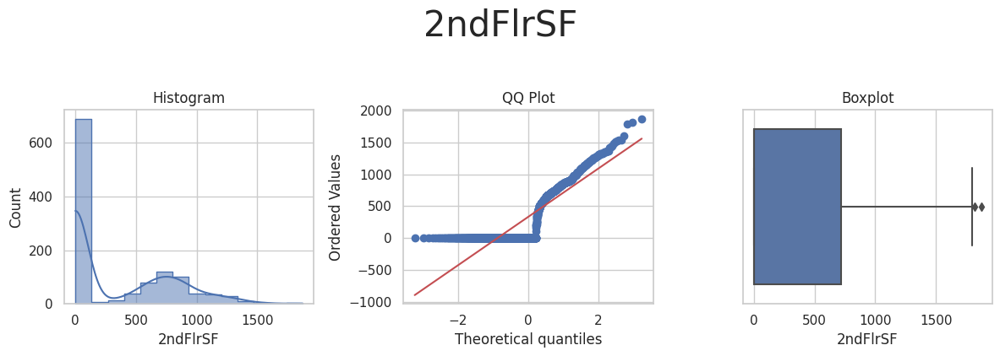

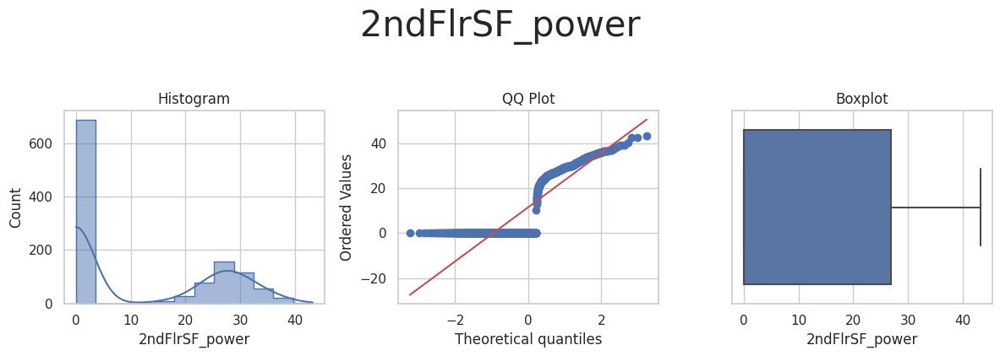

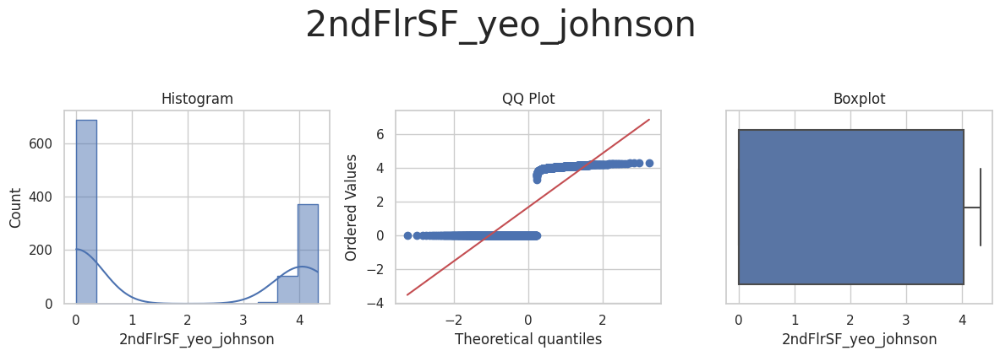



* Variable Analyzed: BedroomAbvGr
* Applied transformation: ['BedroomAbvGr_power', 'BedroomAbvGr_yeo_johnson'] 



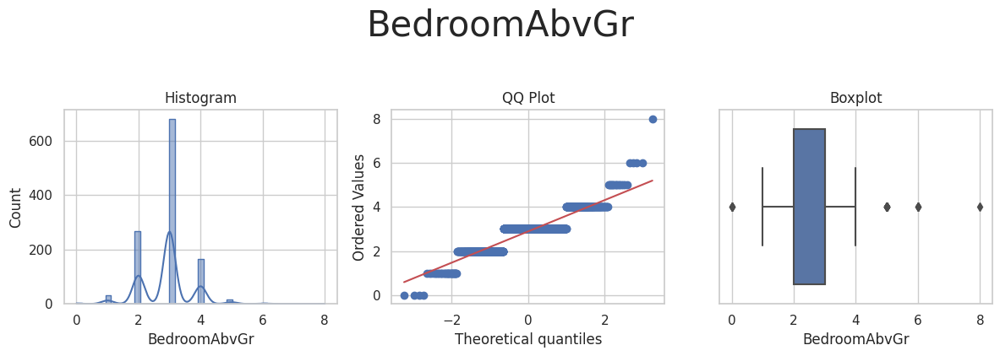

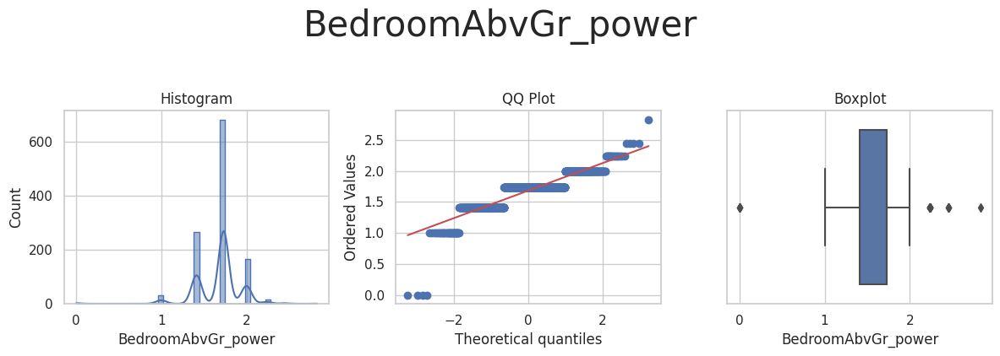

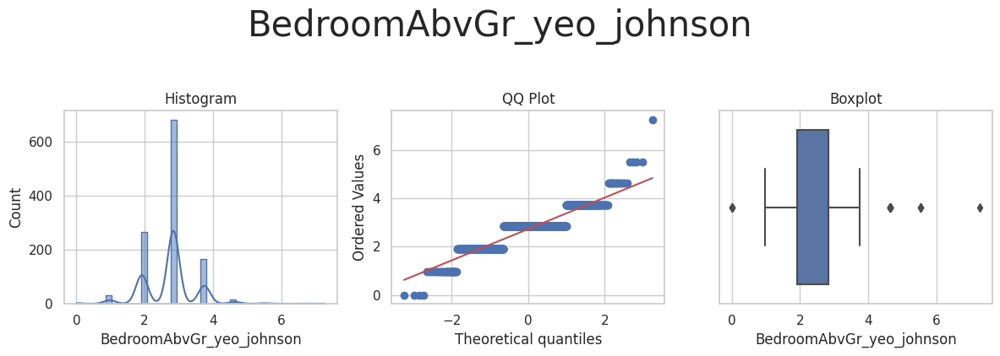



* Variable Analyzed: BsmtFinSF1
* Applied transformation: ['BsmtFinSF1_power', 'BsmtFinSF1_yeo_johnson'] 



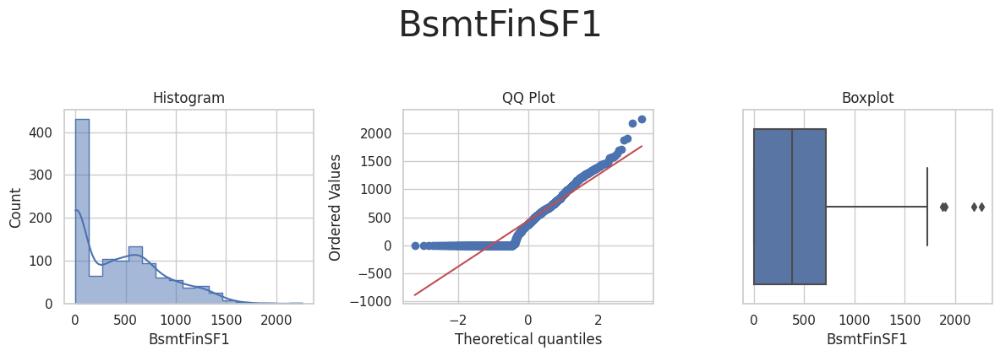

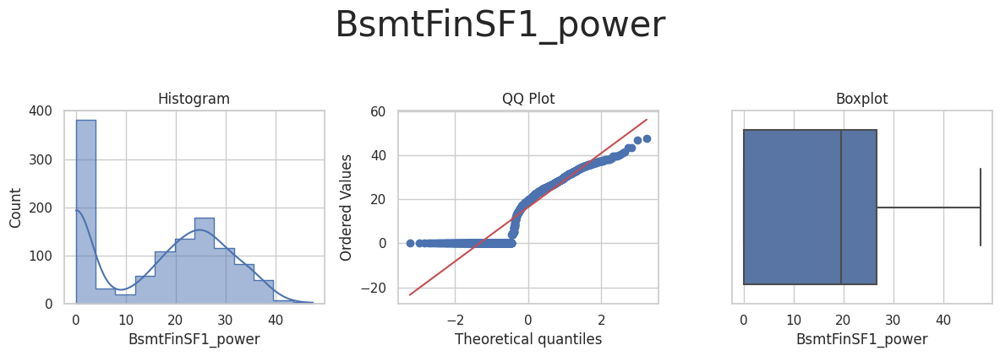

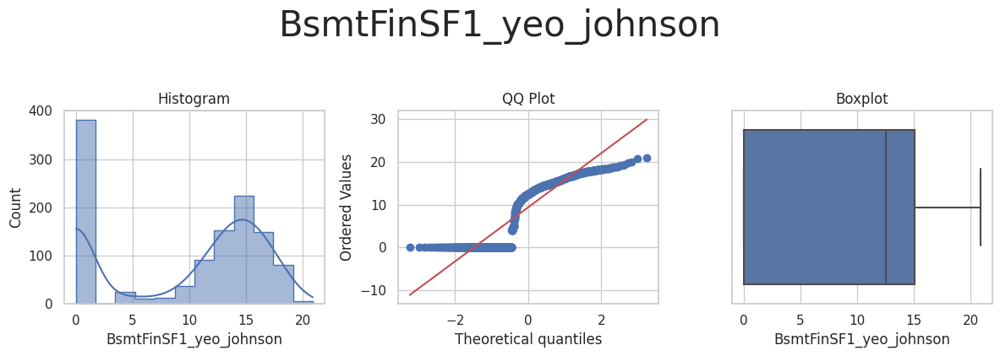



* Variable Analyzed: BsmtUnfSF
* Applied transformation: ['BsmtUnfSF_power', 'BsmtUnfSF_yeo_johnson'] 



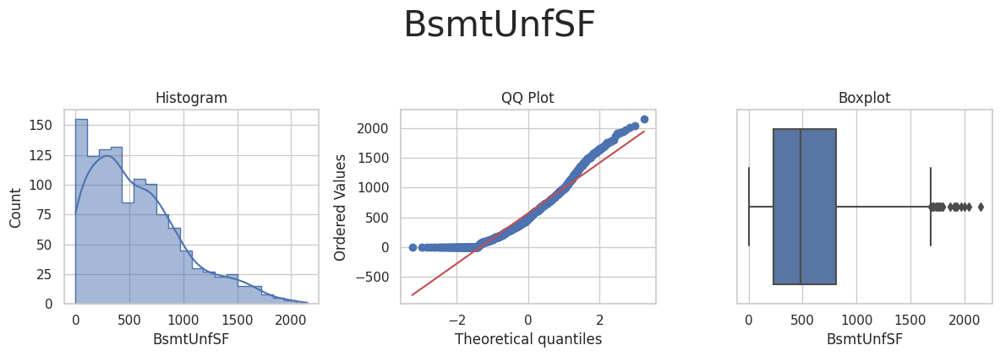

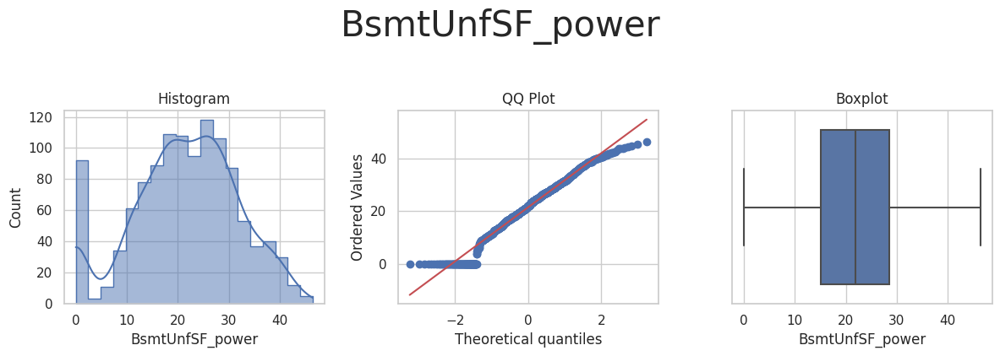

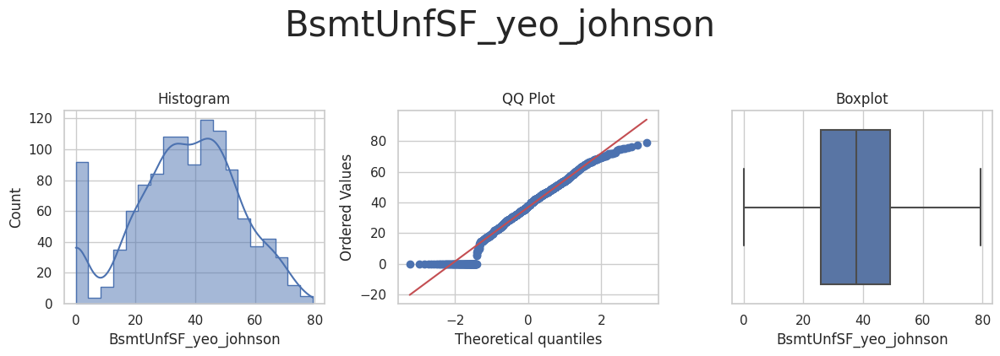



* Variable Analyzed: GarageArea
* Applied transformation: ['GarageArea_power', 'GarageArea_yeo_johnson'] 



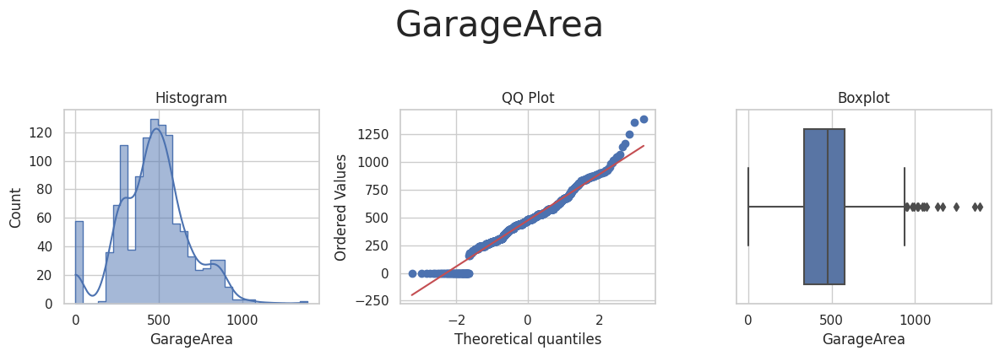

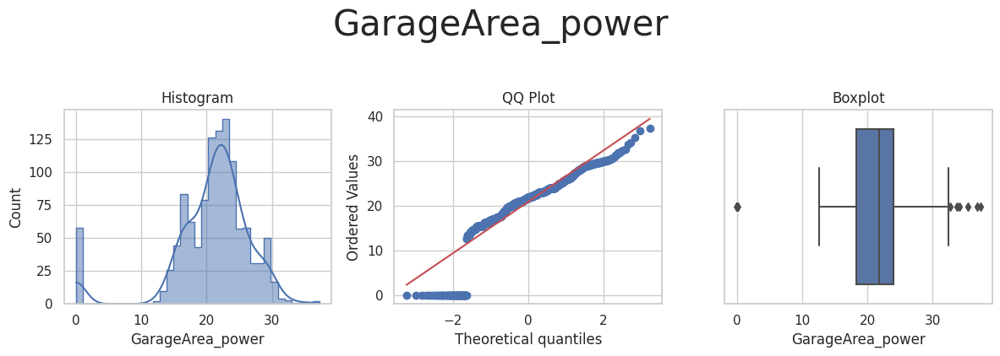

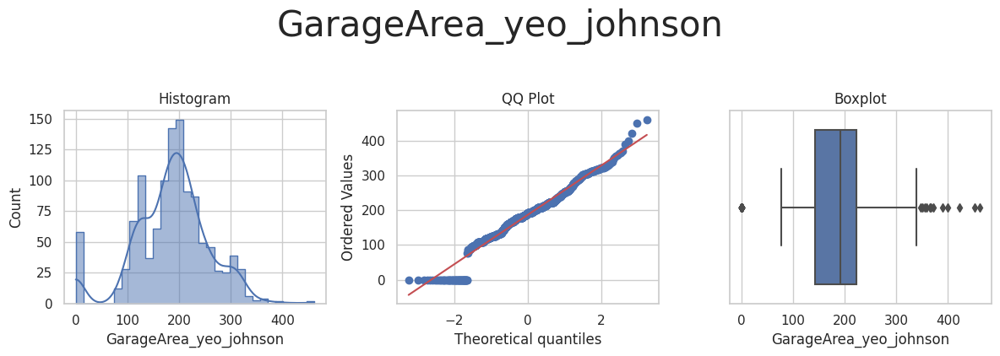



* Variable Analyzed: GrLivArea
* Applied transformation: ['GrLivArea_log_e', 'GrLivArea_log_10', 'GrLivArea_reciprocal', 'GrLivArea_power', 'GrLivArea_box_cox', 'GrLivArea_yeo_johnson'] 



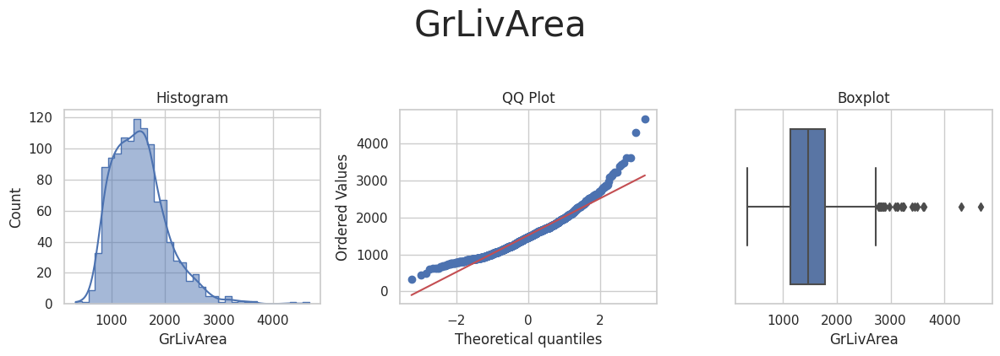

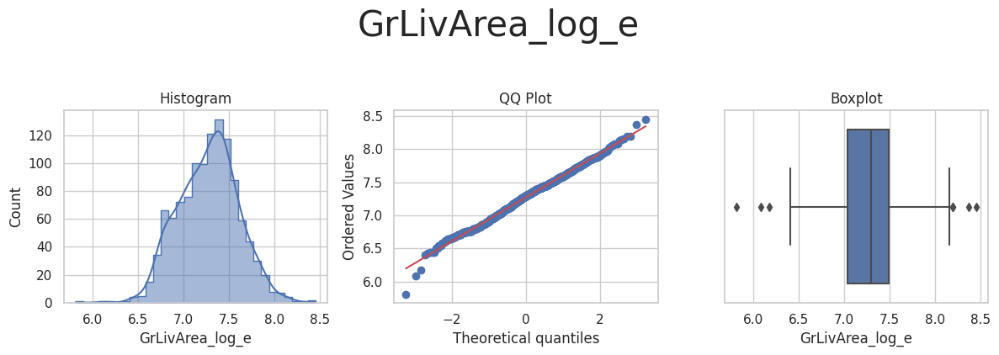

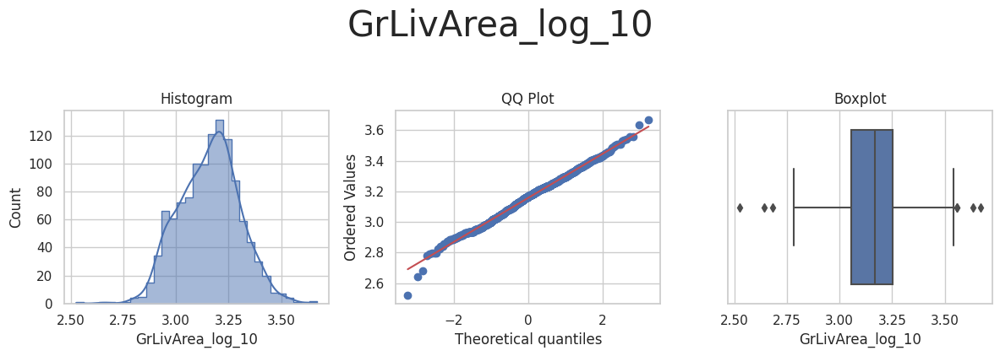

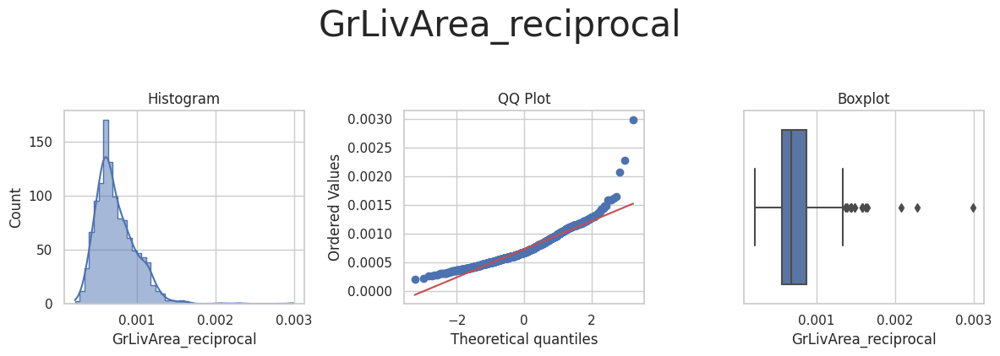

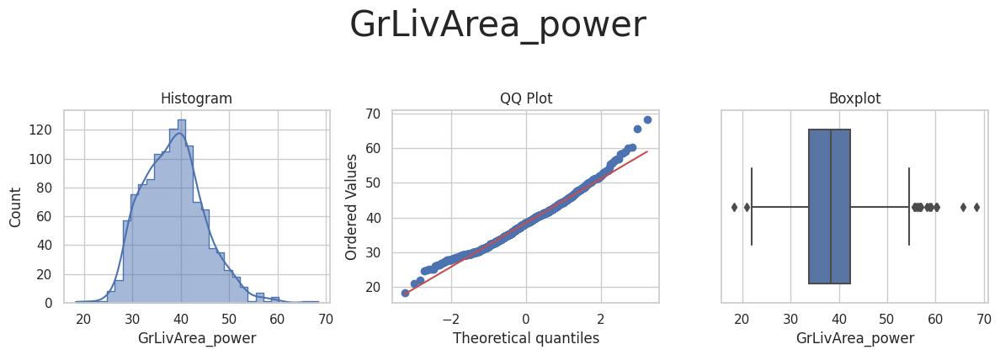

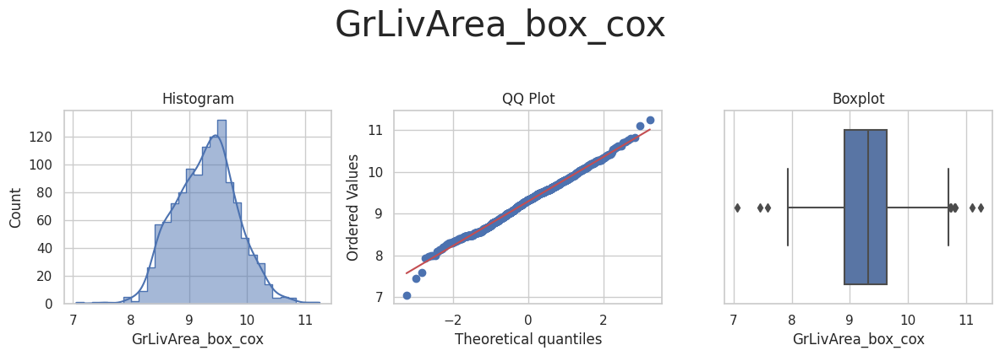

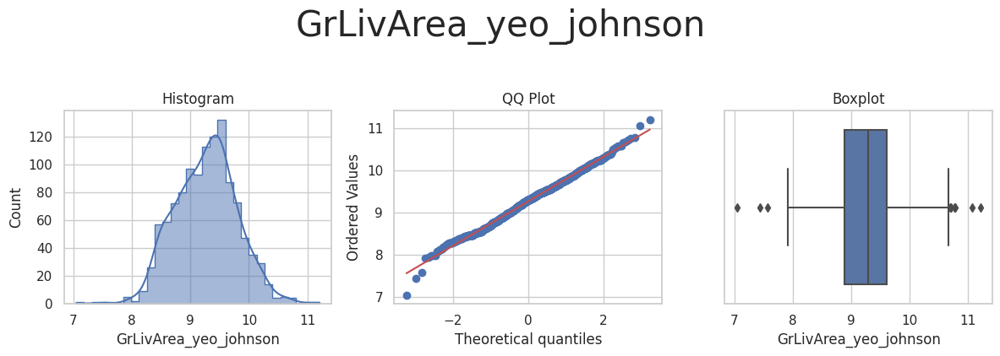



* Variable Analyzed: LotArea
* Applied transformation: ['LotArea_log_e', 'LotArea_log_10', 'LotArea_reciprocal', 'LotArea_power', 'LotArea_box_cox', 'LotArea_yeo_johnson'] 



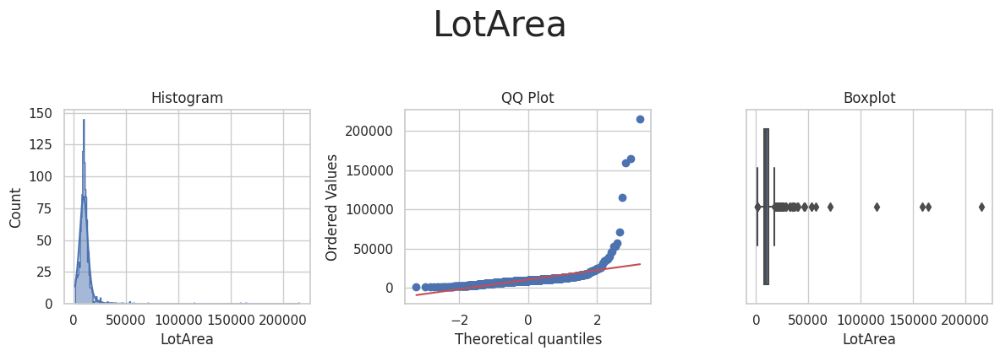

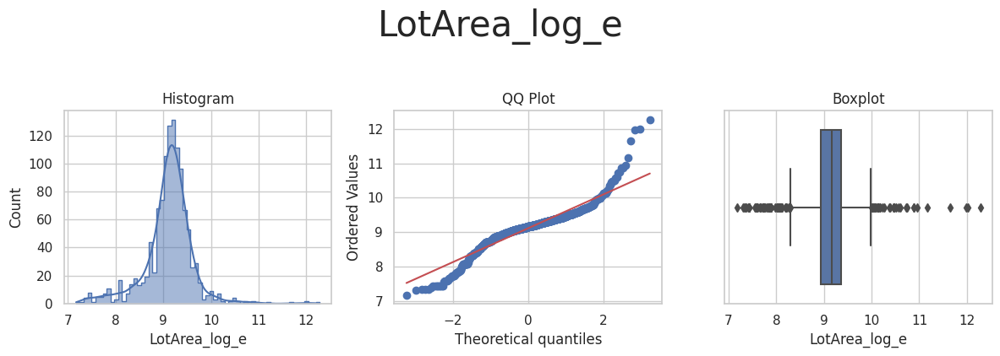

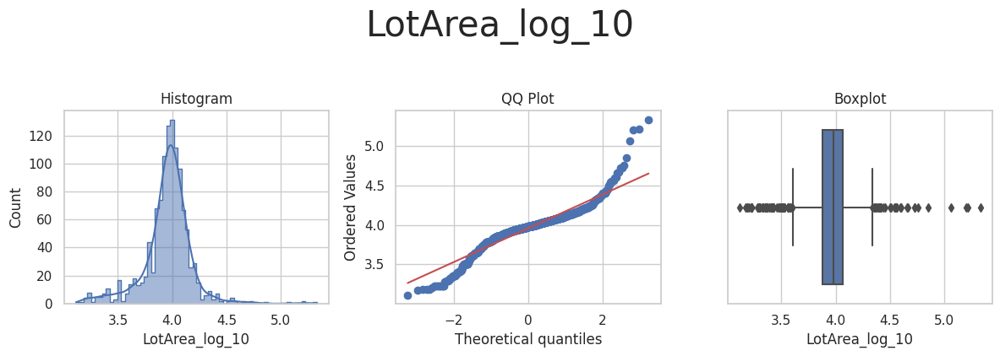

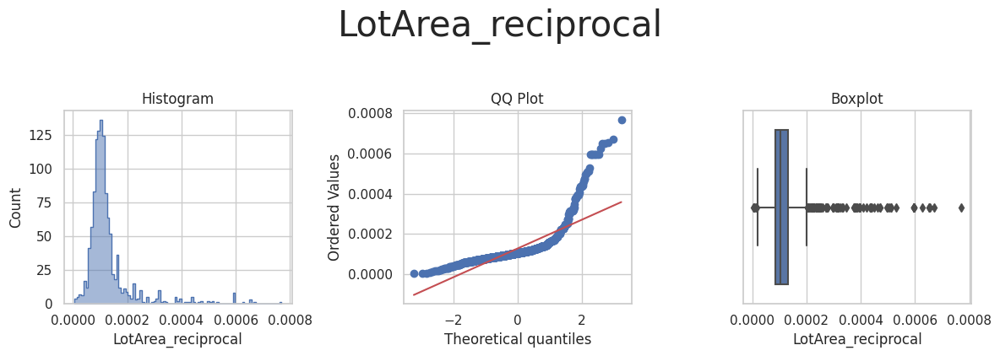

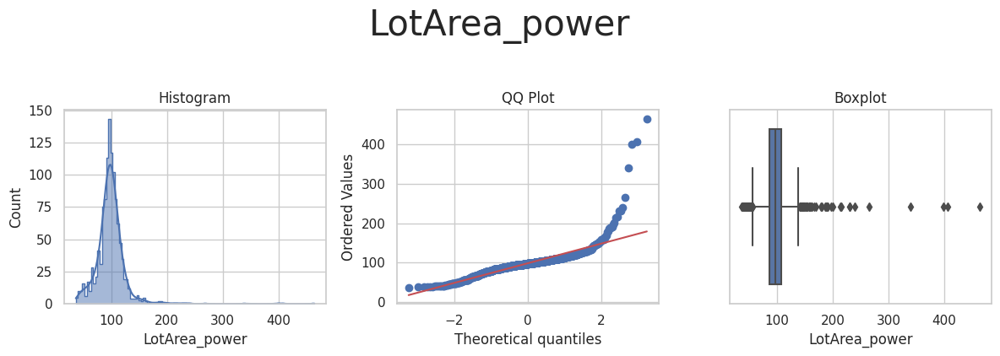

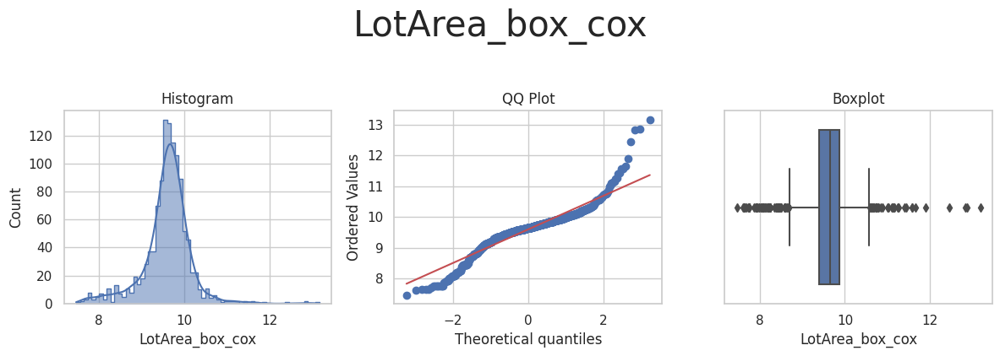

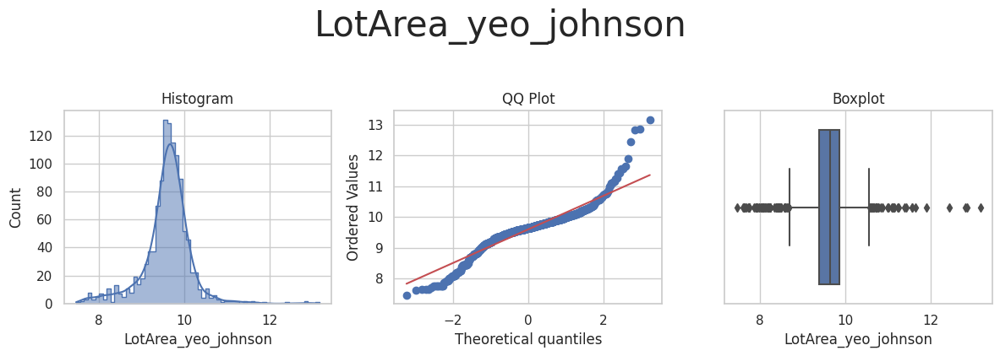



* Variable Analyzed: LotFrontage
* Applied transformation: ['LotFrontage_log_e', 'LotFrontage_log_10', 'LotFrontage_reciprocal', 'LotFrontage_power', 'LotFrontage_box_cox', 'LotFrontage_yeo_johnson'] 



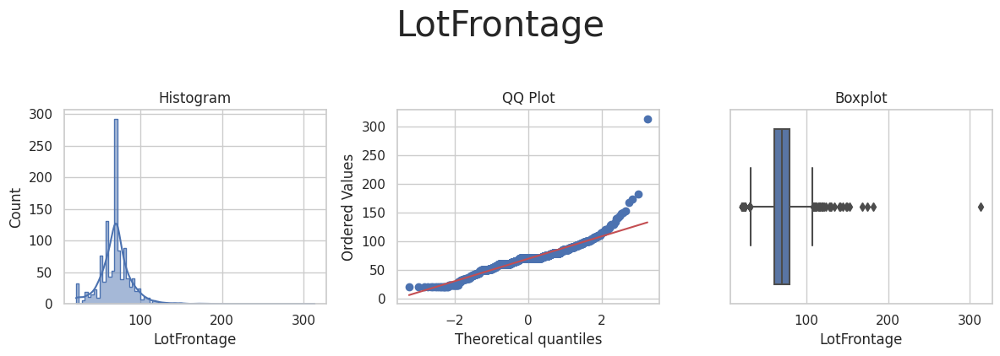

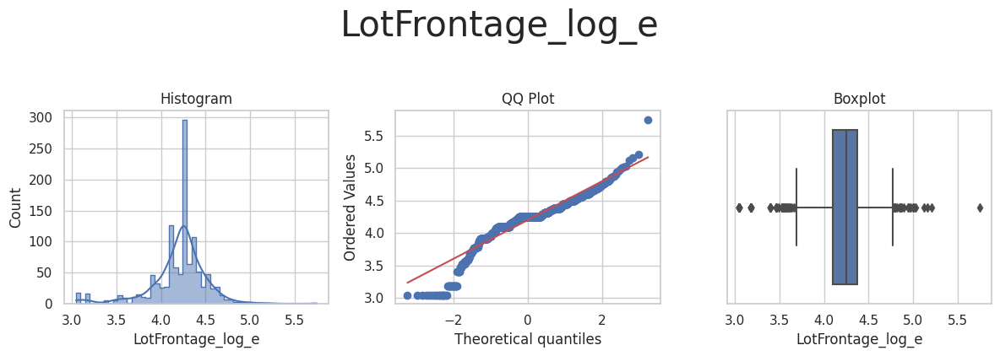

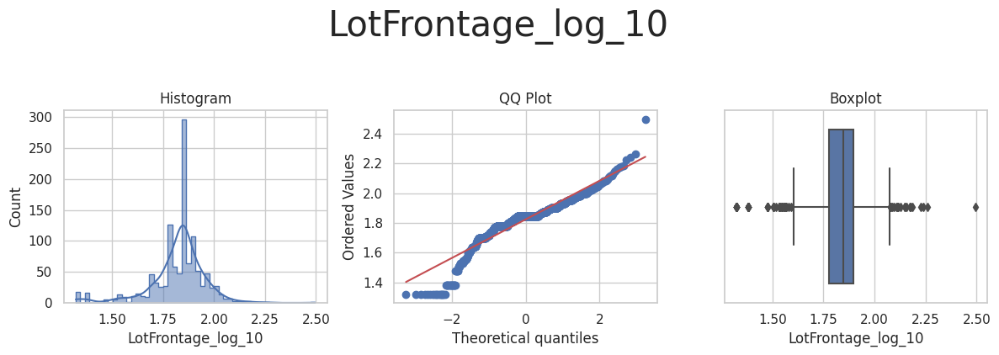

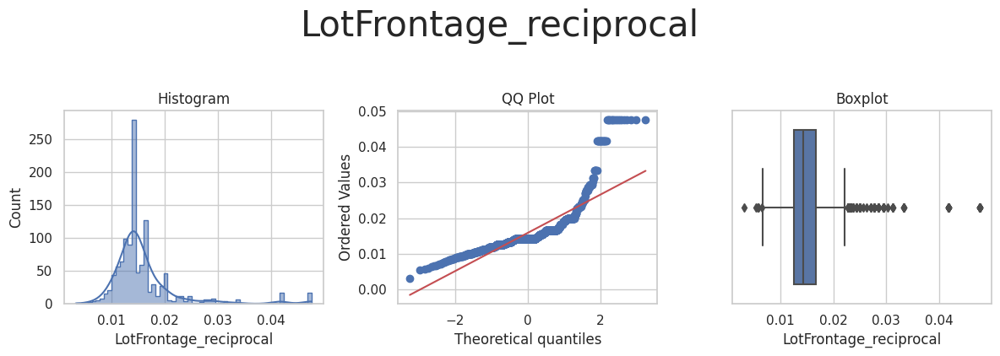

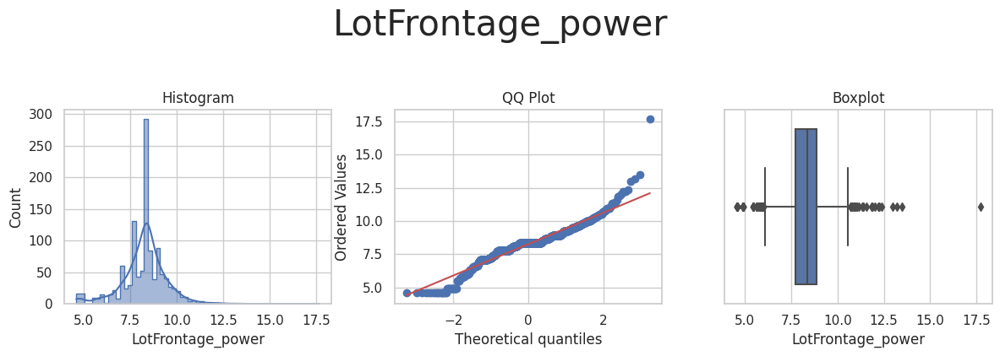

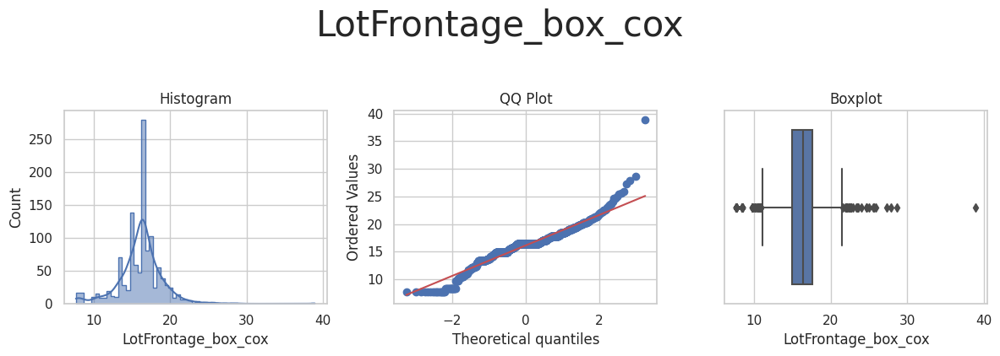

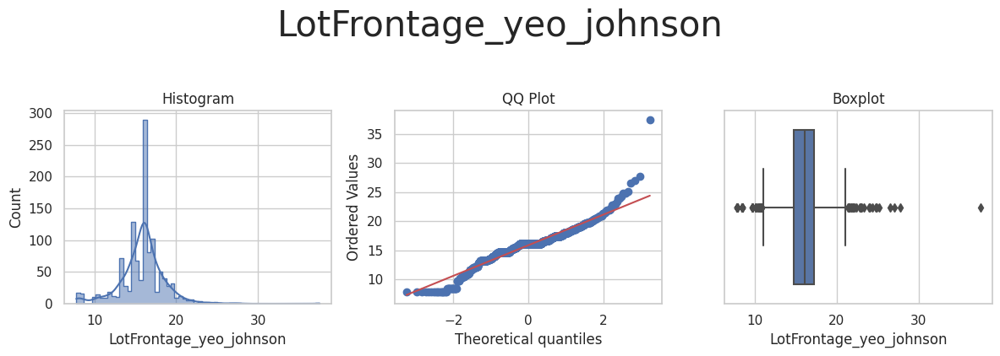



* Variable Analyzed: MasVnrArea
* Applied transformation: ['MasVnrArea_power', 'MasVnrArea_yeo_johnson'] 



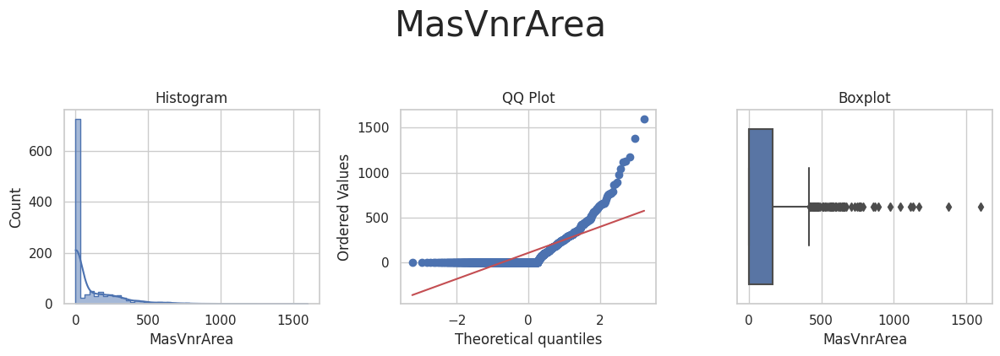

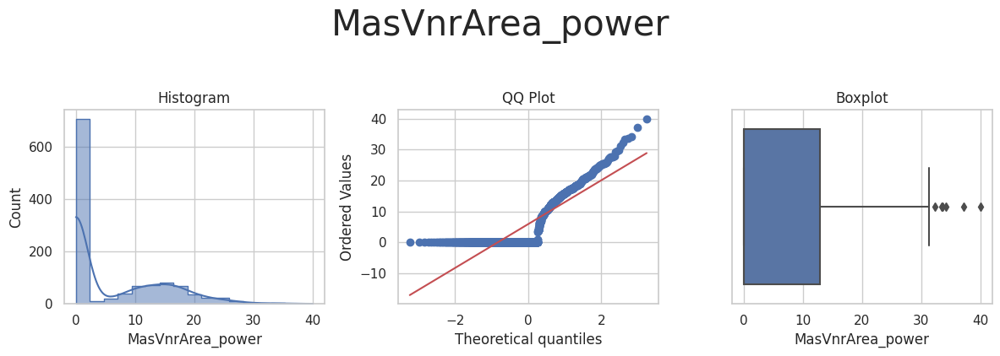

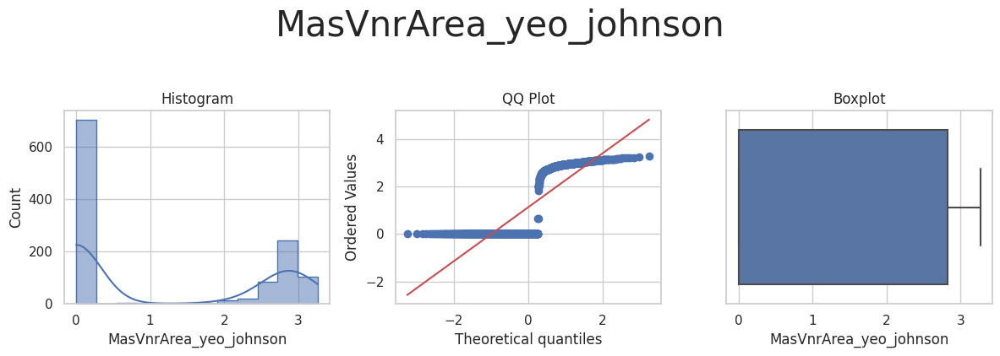



* Variable Analyzed: OpenPorchSF
* Applied transformation: ['OpenPorchSF_power', 'OpenPorchSF_yeo_johnson'] 



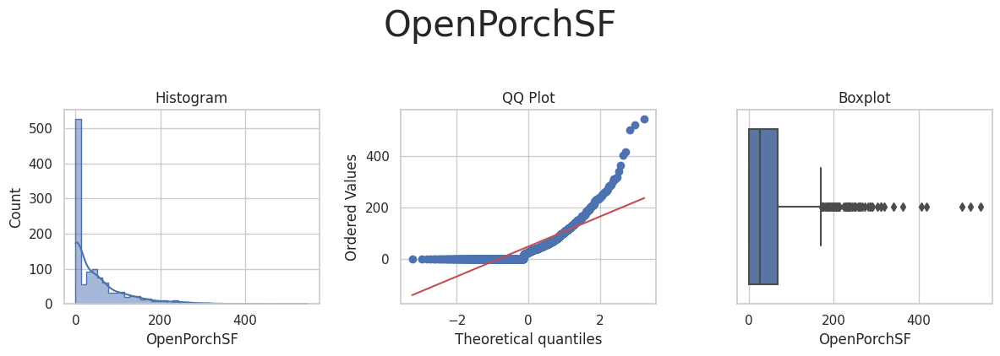

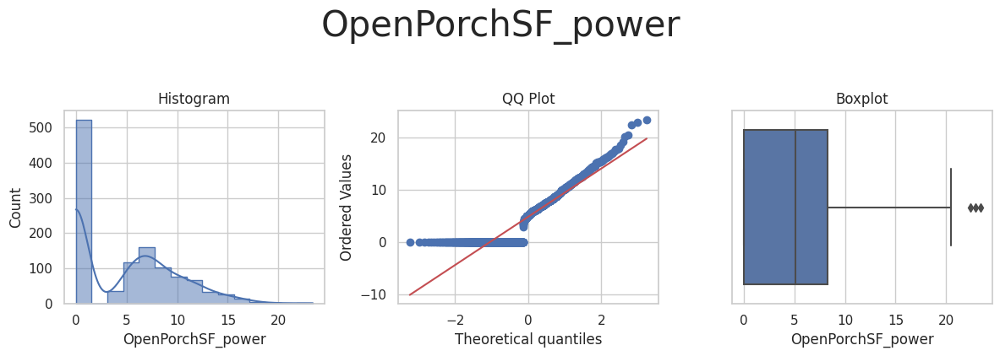

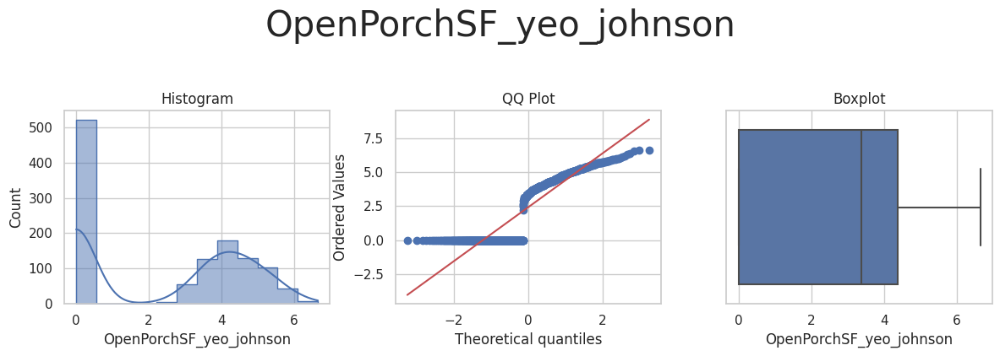



* Variable Analyzed: TotalBsmtSF
* Applied transformation: ['TotalBsmtSF_power', 'TotalBsmtSF_yeo_johnson'] 



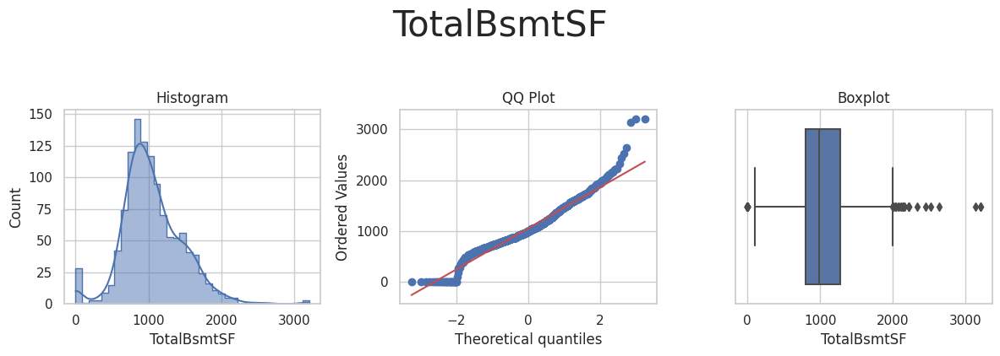

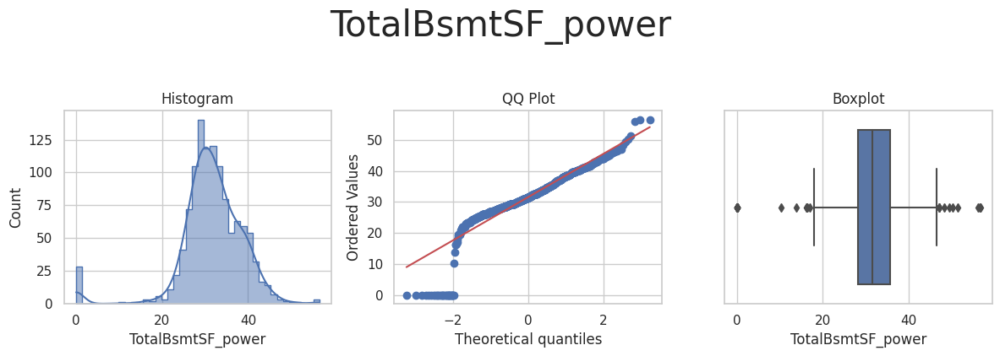

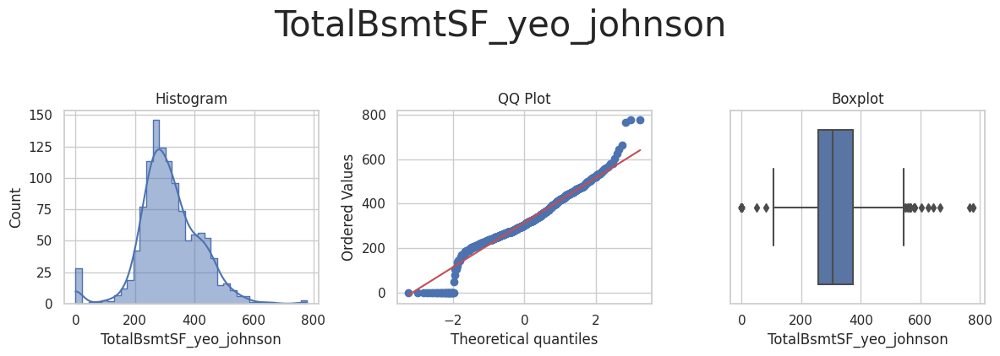



* Variable Analyzed: GarageYrBlt
* Applied transformation: ['GarageYrBlt_log_e', 'GarageYrBlt_log_10', 'GarageYrBlt_reciprocal', 'GarageYrBlt_power', 'GarageYrBlt_box_cox', 'GarageYrBlt_yeo_johnson'] 



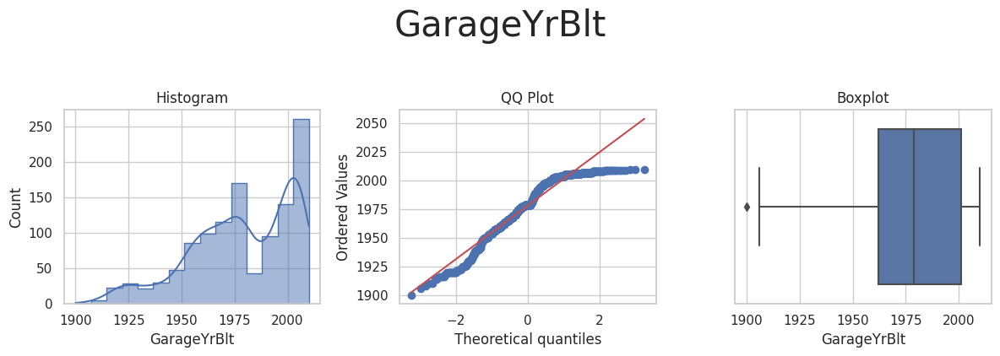

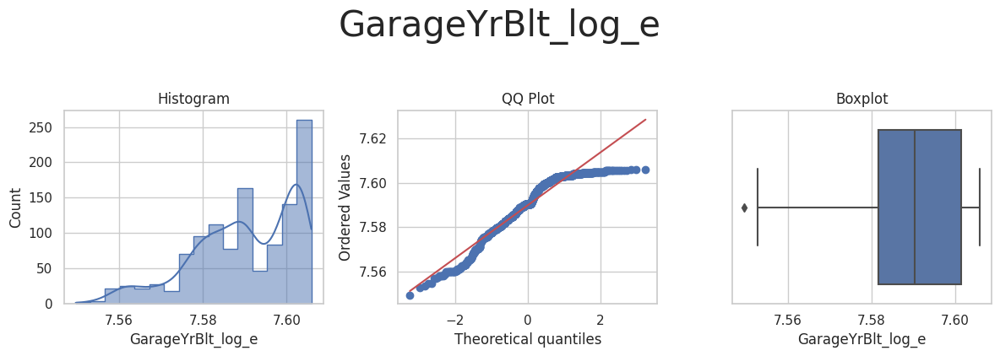

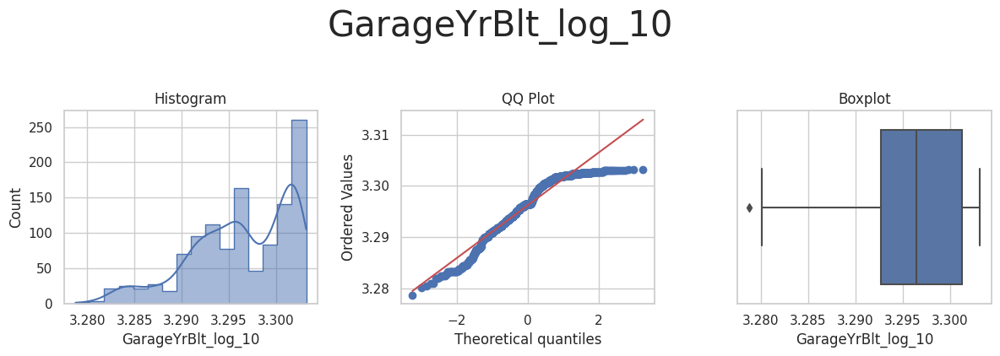

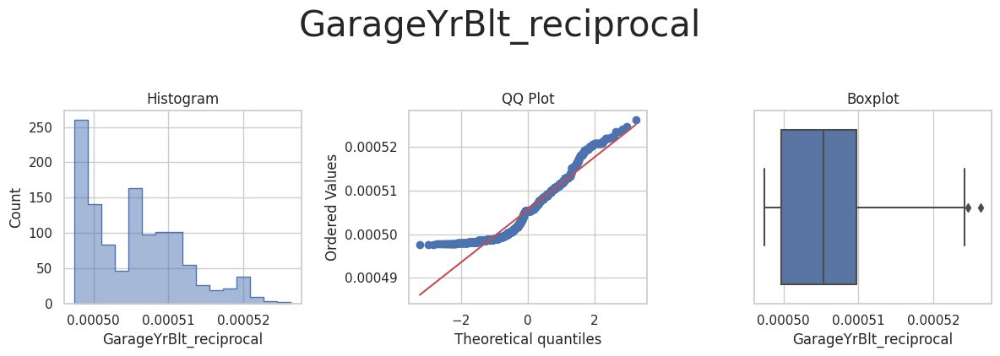

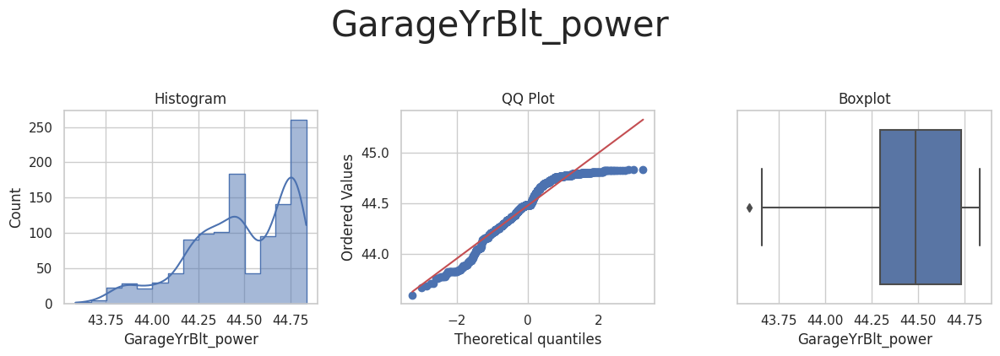

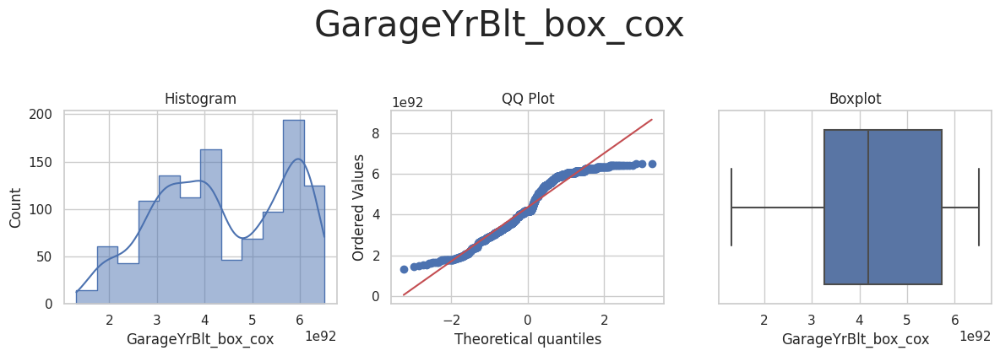

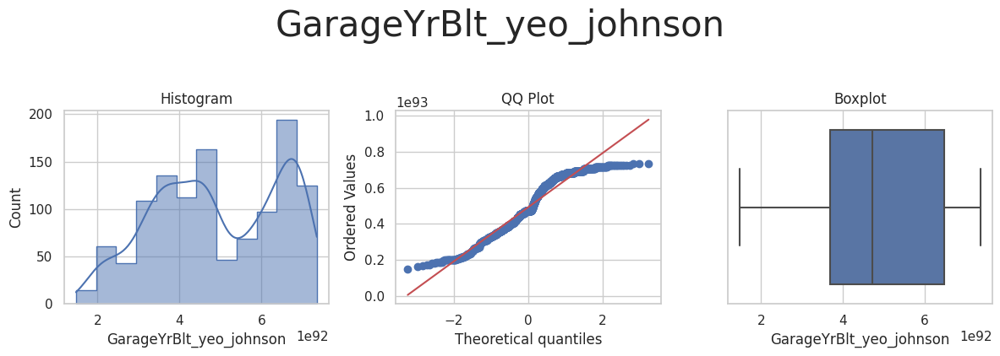



* Variable Analyzed: YearBuilt
* Applied transformation: ['YearBuilt_log_e', 'YearBuilt_log_10', 'YearBuilt_reciprocal', 'YearBuilt_power', 'YearBuilt_box_cox', 'YearBuilt_yeo_johnson'] 



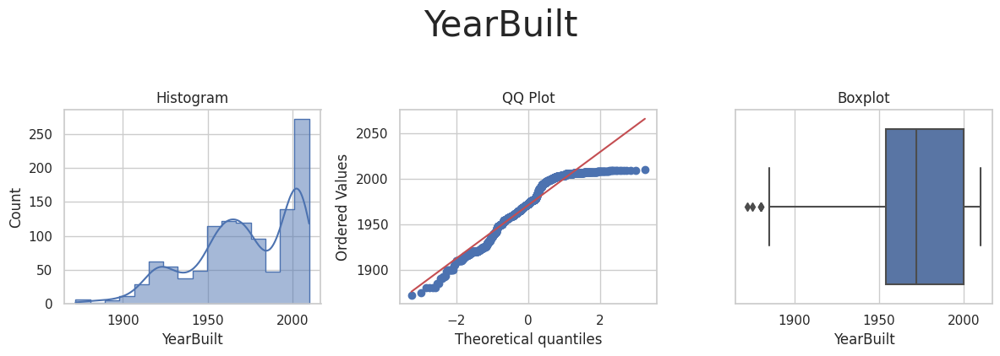

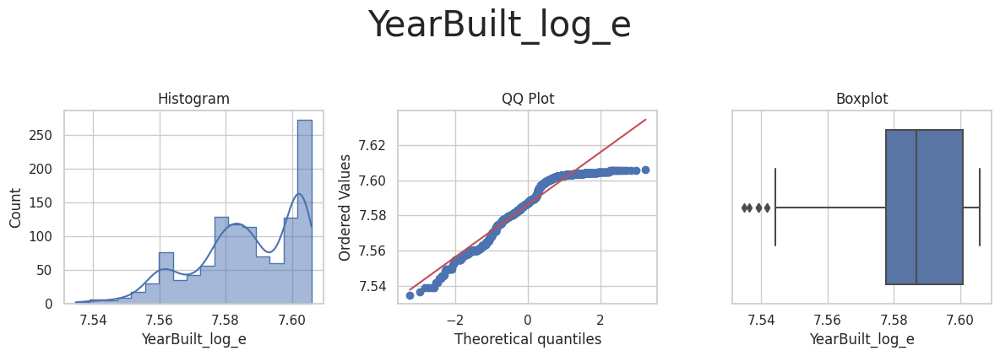

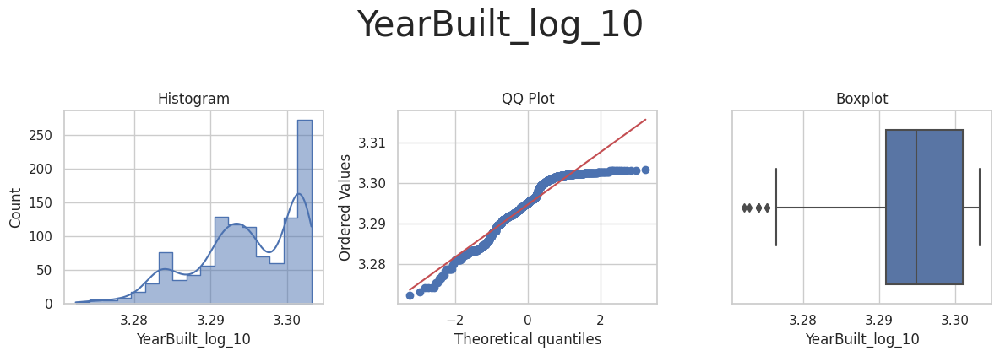

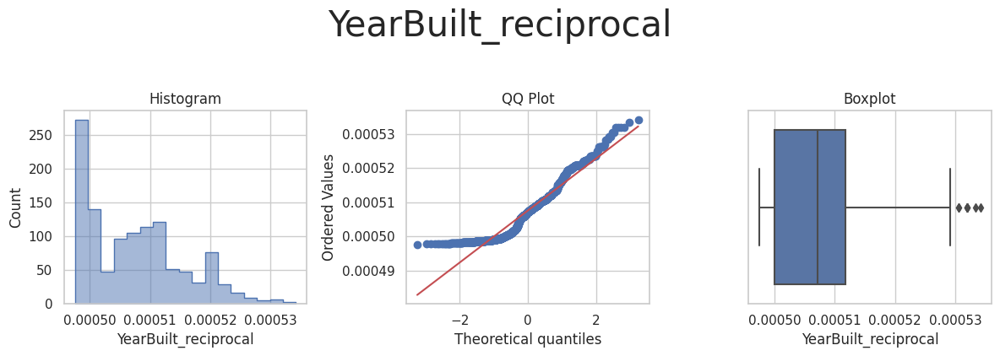

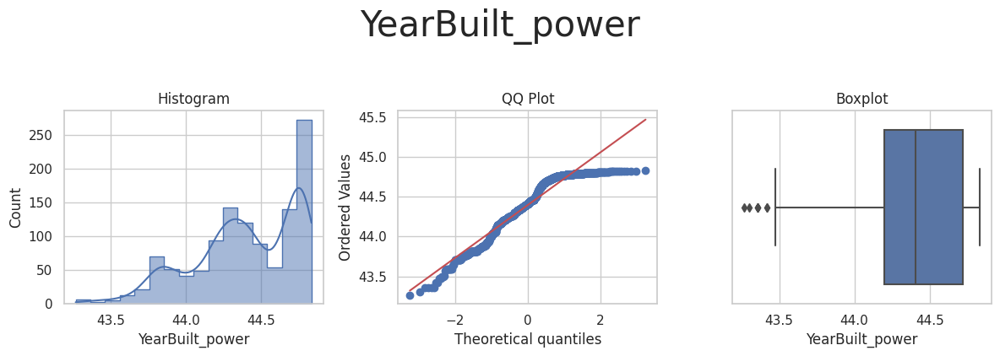

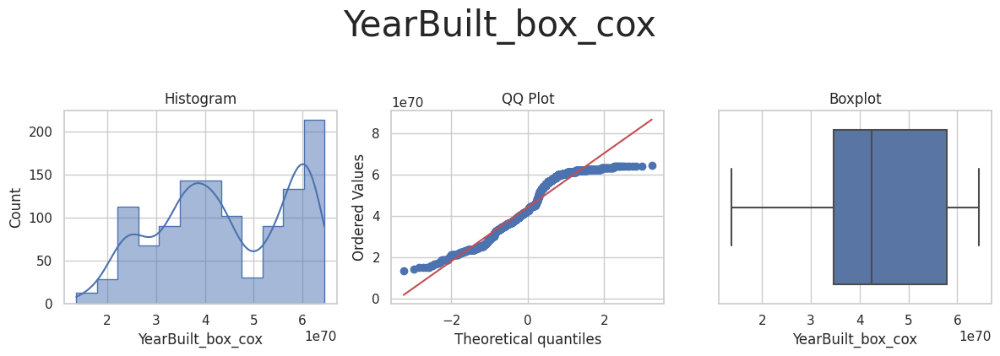

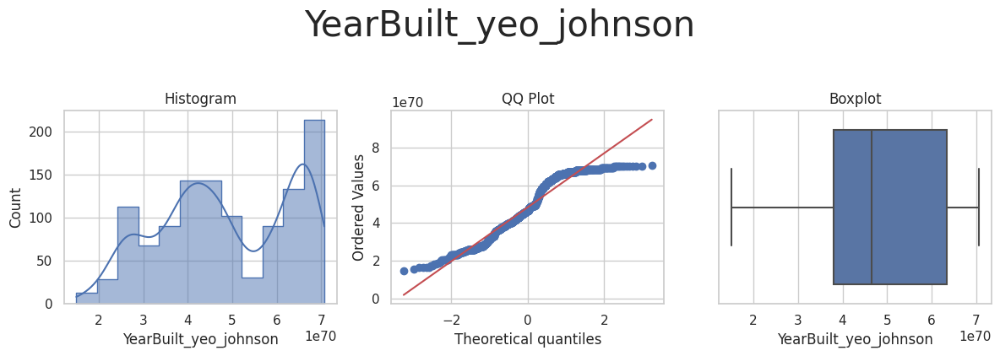



* Variable Analyzed: YearRemodAdd
* Applied transformation: ['YearRemodAdd_log_e', 'YearRemodAdd_log_10', 'YearRemodAdd_reciprocal', 'YearRemodAdd_power', 'YearRemodAdd_box_cox', 'YearRemodAdd_yeo_johnson'] 



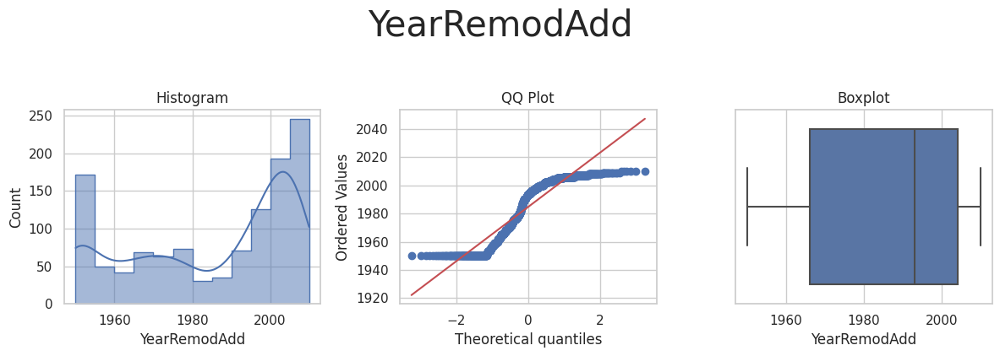

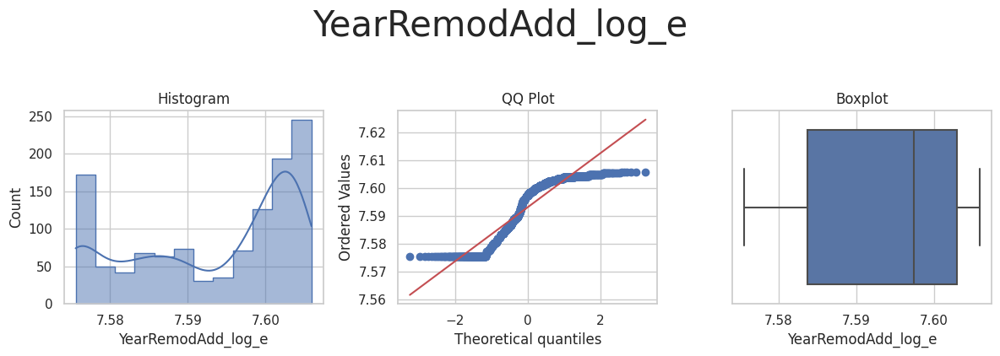

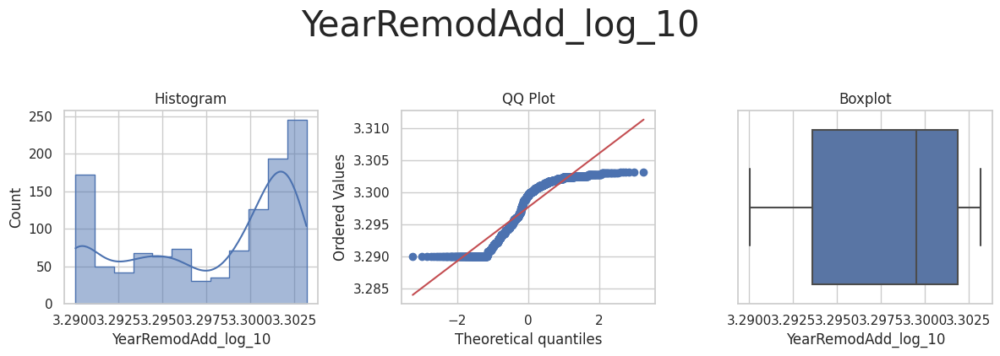

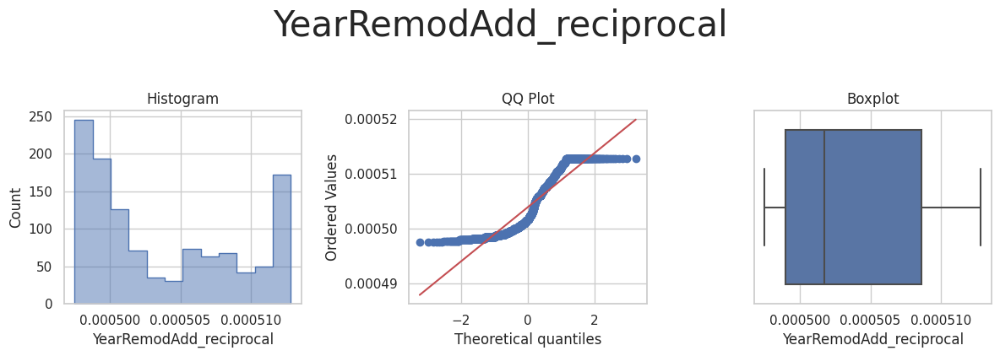

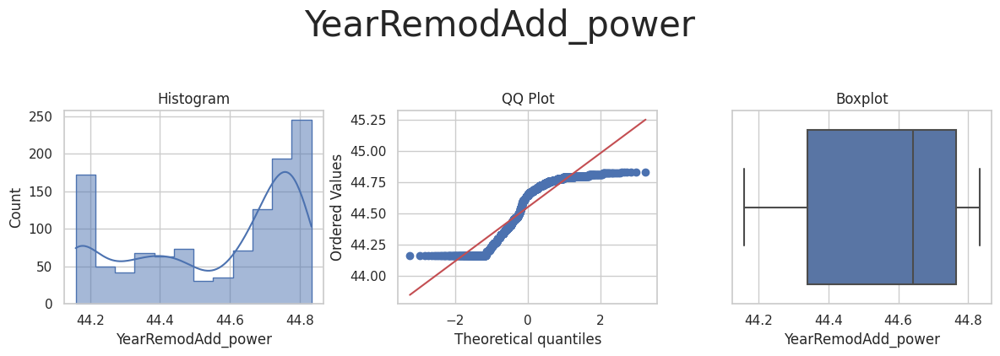

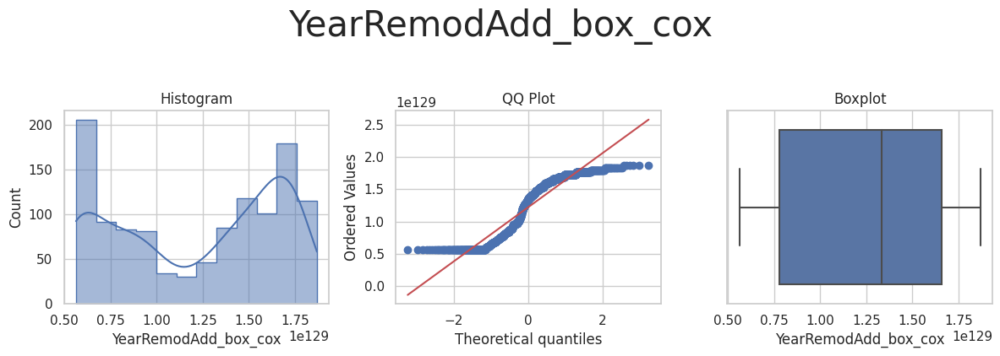

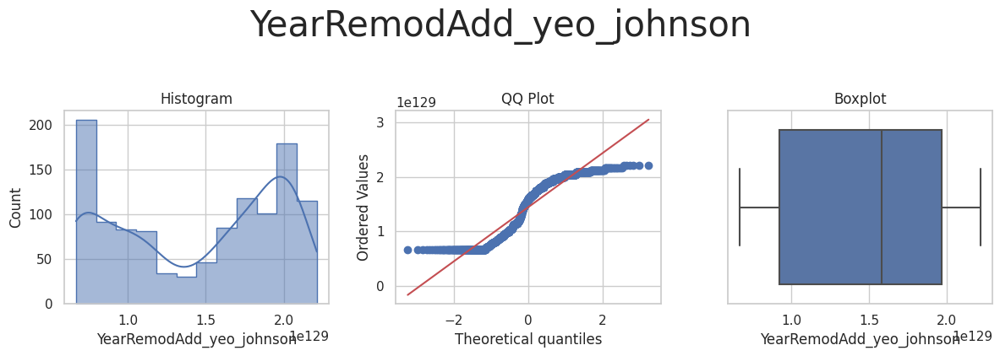

In [18]:
df_numerical_engineering = FeatureEngineeringAnalysis(df=df_numerical_engineering, analysis_type='numerical')

* 1stFlrSF 

    * Original: The histogram leans to the left slightly and the line on the QQ plot does not line up well around after -2 and over 2. The Boxplot shows a fair number of outliers for the higher numbers and none for the lower numbers.
    * The transformations applied: Log e, Log 10, Reciprocal, Power, Box Cox and Yeo Johnson
    * The best transformers were Log e, Log 10, Box Cox and Yeo Johnson. Each of these gave the histogram a much better normal distribution shape and the QQ Plot line was a significantly tighter and only started to deviate at the very end and beginning of the line. The boxplot also had a more centred shape and a better distribution of outliers for both the higher and lower values. 
    * Any of these transformers mentioned above would be considered for the numerical transformation of 1stFlrSF

* 2ndFlrSF

    * Original: The Histogram shows that a large percentage of the data is contained at around 0 and the next notable rise is at 500 to 1000. However, the graph does not resemble a normal distribution. the QQ plot is off the line and again shows a strong count a 0. The boxplot is on the left side of the plot.
    * The transformations applied: Power, Yeo Johnson
    * None of these transformers have successfully made this variable more normally distributed and each of the graphs are showing similar outputs to the original data.
    * Therefore, no numerical transformations will be considered for 2ndFlrSF

* BsmtFinSF1
    * Original: The Histogram starts high at 0 and then slopes down from the left showing that most of the data has a value of 0. The QQ plot leaves the line completely at 0 because of the high count but from 0 to 4 the numbers stay quite close to the line. The Boxplot hugs the left side of the plot ad shows that values above 700 are considered outside of the Upper Quartile Range. 
    * The transformations applied: Power, Yeo Johnson
    * None of these transformers have successfully made this variable more normally distributed and each of the graphs are showing similar outputs to the original data.
    * Therefore, no numerical transformations will be considered for BsmtFinSF1

* BsmtUnfSF
    * Original: The Histogram starts high at 0 and then slopes down from the left showing that most of the data has a value of 0. The QQ plot leaves the line at 0 for the Ordered Values but the values after this don’t deviate greatly from the line. The Boxplot leans more to the left and only shows outliers for the higher values. 
    * The transformations applied: Power, Yeo Johnson
    * Both transformations don’t affect the QQ Plot but have improved the Box plot by giving it a centre position and no longer have any outliers. The Histogram also has a better shape, but it still spikes at the 0 figure. 
    * Therefore, no numerical transformations will be considered for BsmtUnfSF

* GarageArea
    * Original: The Histogram almost has a normal distributed shape, but it raises sharply at the 0 point. The QQ plot leaves the line completely at 0 because of the high count but from 0 to 4 the numbers stay quite close to the line. The Boxplot shows outliers for the higher values. 
    * The transformations applied: Power, Yeo Johnson
    * None of these transformers have successfully made this variable more normally distributed and each of the graphs are showing similar outputs to the original data.
    * Therefore, no numerical transformations will be considered for GarageArea

* GrLivArea
    * Original: The histogram leans to the left slightly and the line on the QQ plot does not line up well around after -2 and over 2. The Boxplot shows a fair number of outliers for the higher numbers and none for the lower numbers.
    * The transformations applied: Log e, Log 10, Reciprocal, Power, Box Cox and Yeo Johnson
    * The best transformers were Log e, Log 10, Box Cox, Yeo Johnson. Each of these gave the histogram a much better normal distribution shape and the QQ Plot line was a significantly tighter and only started to deviate at the very end and beginning of the line. The boxplot also had a more centred shape and a better distribution of outliers for both the higher and lower values. 
    * Any of these transformers mentioned above would be considered for the numerical transformation of GrLivArea

* LotArea
    * Original: The histogram is skewed right and almost all the data is between 0 to 25000. The QQ plot stays on the line well until the far right where it rapidly diverges from it. The Boxplot shows outlining values for the higher values.
    * The transformations applied: Log e, Log 10, Reciprocal, Power, Box Cox and Yeo Johnson
    * The best transformers were Log e, Log 10, Box Cox and Yeo Johnson. Each of these gave the histogram a much better normal distribution shape. The QQ plot now bends at the beginning but the values at the end do not diverge as much. The boxplot also had a more centred shape and a better distribution of outliers for both the higher and lower values.
    * Any of these transformers mentioned above would be considered for the numerical transformation of LotArea

* LotFrontage
    * Original: The histogram shows a normal distribution. The QQ plot follows the line well until a few values at the end of the line. The Boxplot leans to the left and shows more outliers for the higher values.
    * The transformations applied: Log e, Log 10, Reciprocal, Power, Box Cox and Yeo Johnson
    * None of these transformers have improve the Histogram greatly. For the QQ plot its now misses the lower values. The boxplot is more centred for Log e and Log 10. 
    * Therefore, no numerical transformations will be considered for LotFrontage

* MasVnrArea
    * Original: The Histogram starts high at 0 and then slopes down from the left showing that most of the data has a value of 0. The QQ plot shows that none of the values follow the line well. The boxplot hugs the left slide of the plot and shows outliers for the higher values.
    * The transformations applied: Power, Yeo Johnson
    * None of these transformers have successfully made this variable more normally distributed and each of the graphs are showing similar outputs to the original data.
    * Therefore, no numerical transformations will be considered for MasVnrArea

* OpenPorchSF
    * Original: The Histogram starts high at 0 and then slopes down from the left showing that most of the data has a value of 0. The QQ plot shows that none of the values follow the line well. The boxplot hugs the left slide of the plot and shows outliers for the higher values.
    * The transformations applied: Power, Yeo Johnson
    * None of these transformers have successfully made this variable more normally distributed and each of the graphs are showing similar outputs to the original data.
    * Therefore, no numerical transformations will be considered for OpenPorchSF

* TotalBsmtSF
    * Original: The Histogram shows a good fit for normal distribution however the line raises sharply at 0. The QQ plot follows the line well only deviates at -2 and lower because of the high counts of 0 and after 2. The Boxplot is a little to the left and shows more outliers for the higher values. 
    * The transformations applied: Power, Yeo Johnson
    * None of these transformers have successfully made this variable more normally distributed and each of the graphs are showing similar outputs to the original data.
    * Therefore, no numerical transformations will be considered for TotalBsmtSF

* GarageYrBlt
    * Original: Histogram skewed to the left and not showing great normal distribution. The QQ plot follows the line well until the higher numbers where its derivatives from the line. The boxplot leans to the right and only shows outliers for the lower years.
    * The transformations applied: Log e, Log 10, Reciprocal, Power, Box Cox and Yeo Johnson
    * None of these transformers have successfully made this variable more normally distributed and each of the graphs are showing similar outputs to the original data.
    * Therefore, no numerical transformations will be considered for GarageYrBlt

* YearBuilt
    * Original: Histogram skewed to the left and not showing great normal distribution. The QQ plot follows the line well until the higher numbers where its derivatives from the line. The boxplot leans to the right and only shows outliers for the lower years.
    * The transformations applied: Log e, Log 10, Reciprocal, Power, Box Cox and Yeo Johnson
    * None of these transformers have successfully made this variable more normally distributed and each of the graphs are showing similar outputs to the original data.
    * Therefore, no numerical transformations will be considered for YearBuilt

* YearRemodAdd 
    * Original: Histogram not showing any sign of normal distribution. The QQ plot the numbers do not follow the line well and heavily deviates at both the left and right sides. The boxplot shows a greater distribution for the later dates but shows not outliers. 
    * The transformations applied: Log e, Log 10, Reciprocal, Power, Box Cox and Yeo Johnson
    * None of these transformers have successfully made this variable more normally distributed and each of the graphs are showing similar outputs to the original data.
    * Therefore, no numerical transformations will be considered for YearRemodAdd


### SmartCorrelatedSelected Variables

We will now use the smart correlated selected function to remove features that have high correlation between each other. This reduces the number of features by only keeping the best one of the group. 

In [15]:
df_smart_engineering = TrainSet.copy()
df_smart_engineering = df_smart_engineering.drop(['SalePrice'],axis=1)
df_smart_engineering.head()

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtUnfSF,GarageArea,GarageFinish,GarageYrBlt,...,KitchenQual,LotArea,LotFrontage,MasVnrArea,OpenPorchSF,OverallCond,OverallQual,TotalBsmtSF,YearBuilt,YearRemodAdd
0,1828,0.0,3.0,0,48,0,1774,774,0,2007.0,...,0,11694,90.0,452.0,108,5,9,1822,2007,2007
1,894,0.0,2.0,1,0,1,894,308,0,1962.0,...,1,6600,60.0,0.0,0,5,5,894,1962,1962
2,964,0.0,2.0,1,713,2,163,432,0,1921.0,...,1,13360,80.0,0.0,0,7,5,876,1921,2006
3,1689,0.0,3.0,1,1218,3,350,857,1,2002.0,...,0,13265,70.0,148.0,59,5,8,1568,2002,2002
4,1541,0.0,3.0,1,0,1,1541,843,1,2001.0,...,0,13704,118.0,150.0,81,5,7,1541,2001,2002


In [16]:
from feature_engine.selection import SmartCorrelatedSelection
corr_sel = SmartCorrelatedSelection(variables=None, method="spearman", threshold=0.6, selection_method="variance")

corr_sel.fit_transform(df_smart_engineering)
corr_sel.correlated_feature_sets_

[{'1stFlrSF', 'TotalBsmtSF'},
 {'2ndFlrSF', 'GrLivArea'},
 {'GarageYrBlt', 'YearBuilt', 'YearRemodAdd'}]

We can see above that there were 3 groups of strongly correlated features we will now run the code to find the best features to drop.

In [17]:
corr_sel.features_to_drop_

['1stFlrSF', '2ndFlrSF', 'GarageYrBlt', 'YearRemodAdd']

---

# Conclusion and next steps

Below I will list the transformations needed for feature engineering.

* Ordinal categorical encoding: BsmtExposure, BsmtFinType1, GarageFinish, KitchenQual
* Numerical encoding - (Log e, Log 10, Box Cox and Yeo Johnson): 1stFlrSF, GrLivArea, LotArea
* Smart Correlation Selection: 1stFlrSF, 2ndFlrSF, GarageYrBlt, YearRemodAdd

Next, we will use these transformations in our next notebook Modelling and evaluation – prediction sale price in the ML pipeline. 

---